In [48]:
# Standard Libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import pickle
import os
import joblib

# Data Profiling
from ydata_profiling import ProfileReport
import sweetviz as sv

# Statistical Analysis
from statsmodels.stats.outliers_influence import variance_inflation_factor

# Preprocessing
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.feature_selection import RFE
from sklearn.decomposition import PCA

# Model Evaluation
from sklearn.metrics import mean_absolute_error
from sklearn.model_selection import cross_val_score

# Machine Learning Models
from sklearn.linear_model import LinearRegression, Ridge, Lasso
from sklearn.ensemble import (
    RandomForestRegressor,
    GradientBoostingRegressor,
    VotingRegressor,
    StackingRegressor,
)
import xgboost as xgb
import lightgbm as lgb
from lightgbm import early_stopping

# Deep Learning
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout, Input
from tensorflow.keras.optimizers import Adam

# Optimization and Hyperparameter Tuning
import optuna
from optuna.integration import LightGBMPruningCallback

# Model Interpretability
import shap

# Experiment Tracking
import mlflow
import mlflow.sklearn

In [49]:
# Load the datasets
previous_lives_training = pd.read_csv(r"C:\Users\User\Projects_for_Competitions_Companies\Nordeus_Data_Science_Challenge_2024\data\raw\previous_lives_training_data.csv")
registration_data_training = pd.read_csv(r"C:\Users\User\Projects_for_Competitions_Companies\Nordeus_Data_Science_Challenge_2024\data\raw\registration_data_training.csv")
previous_lives_test = pd.read_csv(r"C:\Users\User\Projects_for_Competitions_Companies\Nordeus_Data_Science_Challenge_2024\data\raw\previous_lives_test_data.csv")
registration_data_test = pd.read_csv(r"C:\Users\User\Projects_for_Competitions_Companies\Nordeus_Data_Science_Challenge_2024\data\raw\registration_data_test.csv")

In [50]:
# Check basic information about each dataset
print("previous_lives_training")
print('='*30)
previous_lives_training_info = previous_lives_training.info()
print("\n")
print("registration_data_training")
print('='*30)
registration_data_training_info = registration_data_training.info()
print("\n")
print("previous_lives_test")
print('='*30)
previous_lives_test_info = previous_lives_test.info()
print("\n")
print("registration_data_test")
print('='*30)
registration_data_test_info = registration_data_test.info()

previous_lives_training
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 84941 entries, 0 to 84940
Data columns (total 11 columns):
 #   Column                              Non-Null Count  Dtype 
---  ------                              --------------  ----- 
 0   user_id                             84941 non-null  int64 
 1   registration_date                   84941 non-null  object
 2   registration_season_day             84941 non-null  int64 
 3   registration_country                84941 non-null  object
 4   registration_channel_detailed       84941 non-null  object
 5   registration_store                  84941 non-null  object
 6   registration_platform_specific      84941 non-null  object
 7   is_payer_lifetime                   84941 non-null  bool  
 8   days_active_lifetime                84941 non-null  int64 
 9   transaction_count_iap_lifetime      84941 non-null  int64 
 10  is_rewarded_video_watcher_lifetime  84941 non-null  bool  
dtypes: bool(2), int64(4), object(5

In [51]:
def missing_value_summary(data):
    # Calculate the number of missing values and their percentage
    missing_value = data.isnull().sum().reset_index()
    missing_value.columns = ['Variable', 'Number of Missing']
    missing_value['Percentage of Missing'] = (missing_value['Number of Missing'] / data.shape[0] * 100).round(2)

    # Sort the summary by the percentage of missing values in descending order
    missing_value = missing_value.sort_values(by='Percentage of Missing', ascending=False).reset_index(drop=True)

    return missing_value

In [52]:
# Display the missing value summary
missing_value_summary(previous_lives_training)

,Variable,Number of Missing,Percentage of Missing
0,user_id,0,0.0
1,registration_date,0,0.0
2,registration_season_day,0,0.0
3,registration_country,0,0.0
4,registration_channel_detailed,0,0.0
5,registration_store,0,0.0
6,registration_platform_specific,0,0.0
7,is_payer_lifetime,0,0.0
8,days_active_lifetime,0,0.0
9,transaction_count_iap_lifetime,0,0.0


In [53]:
# Check basic information about previous_lives_training dataset
print ("Rows     : " ,previous_lives_training.shape[0])
print ("Columns  : " ,previous_lives_training.shape[1])
print('='*30)
print ("Features : \n" ,previous_lives_training.columns.tolist())
print('='*30)
print ("Missing values :  ", previous_lives_training.isnull().sum().values.sum())
print('='*30)
print ("Unique values :  \n",previous_lives_training.nunique())

Rows     :  84941
Columns  :  11
Features : 
 ['user_id', 'registration_date', 'registration_season_day', 'registration_country', 'registration_channel_detailed', 'registration_store', 'registration_platform_specific', 'is_payer_lifetime', 'days_active_lifetime', 'transaction_count_iap_lifetime', 'is_rewarded_video_watcher_lifetime']
Missing values :   0
Unique values :  
 user_id                               50000
registration_date                       699
registration_season_day                  28
registration_country                    187
registration_channel_detailed             3
registration_store                        6
registration_platform_specific            7
is_payer_lifetime                         2
days_active_lifetime                    519
transaction_count_iap_lifetime          127
is_rewarded_video_watcher_lifetime        2
dtype: int64


In [54]:
# Display the missing value summary
missing_value_summary(registration_data_training)

,Variable,Number of Missing,Percentage of Missing
0,registration_device_manufacturer,1813,3.63
1,avg_age_top_11_players,3,0.01
2,user_id,0,0.00
3,transaction_count_rewarded_video,0,0.00
4,training_count,0,0.00
5,avg_stars_top_3_players,0,0.00
6,avg_stars_top_11_players,0,0.00
7,money_stash,0,0.00
8,morale_spent,0,0.00
9,treatments_spent,0,0.00


In [55]:
# Check basic information about registration_data_training dataset
print ("Rows     : " ,registration_data_training.shape[0])
print ("Columns  : " ,registration_data_training.shape[1])
print('='*30)
print ("Features : \n" ,registration_data_training.columns.tolist())
print('='*30)
print ("Missing values :  ", registration_data_training.isnull().sum().values.sum())
print('='*30)
print ("Unique values :  \n",registration_data_training.nunique())

Rows     :  50000
Columns  :  30
Features : 
 ['user_id', 'registration_time_utc', 'registration_platform_specific', 'registration_country', 'registration_store', 'registration_season_day', 'registration_channel_detailed', 'registration_device_type', 'registration_device_manufacturer', 'session_count', 'playtime', 'number_of_devices_used', 'total_match_played_count', 'total_match_won_count', 'total_match_watched_count', 'transaction_count_iap', 'transaction_count_rewarded_video', 'tokens_spent', 'tokens_stash', 'tokens_bought', 'rests_stash', 'rests_spent', 'treatments_spent', 'morale_spent', 'money_stash', 'avg_stars_top_11_players', 'avg_stars_top_3_players', 'avg_age_top_11_players', 'training_count', 'days_active_first_28_days_after_registration']
Missing values :   1816
Unique values :  
 user_id                                         50000
registration_time_utc                           49410
registration_platform_specific                      7
registration_country             

In [56]:
# Display the missing value summary
missing_value_summary(previous_lives_test)

,Variable,Number of Missing,Percentage of Missing
0,user_id,0,0.0
1,registration_date,0,0.0
2,registration_season_day,0,0.0
3,registration_country,0,0.0
4,registration_channel_detailed,0,0.0
5,registration_store,0,0.0
6,registration_platform_specific,0,0.0
7,is_payer_lifetime,0,0.0
8,days_active_lifetime,0,0.0
9,transaction_count_iap_lifetime,0,0.0


In [57]:
# Check basic information about previous_lives_test dataset
print ("Rows     : " ,previous_lives_test.shape[0])
print ("Columns  : " ,previous_lives_test.shape[1])
print('='*30)
print ("Features : \n" ,previous_lives_test.columns.tolist())
print('='*30)
print ("Missing values :  ", previous_lives_test.isnull().sum().values.sum())
print('='*30)
print ("Unique values :  \n",previous_lives_test.nunique())

Rows     :  86113
Columns  :  11
Features : 
 ['user_id', 'registration_date', 'registration_season_day', 'registration_country', 'registration_channel_detailed', 'registration_store', 'registration_platform_specific', 'is_payer_lifetime', 'days_active_lifetime', 'transaction_count_iap_lifetime', 'is_rewarded_video_watcher_lifetime']
Missing values :   0
Unique values :  
 user_id                               50000
registration_date                       724
registration_season_day                  28
registration_country                    199
registration_channel_detailed             3
registration_store                        6
registration_platform_specific            7
is_payer_lifetime                         2
days_active_lifetime                    530
transaction_count_iap_lifetime          122
is_rewarded_video_watcher_lifetime        2
dtype: int64


In [58]:
# Display the missing value summary
missing_value_summary(registration_data_test)

,Variable,Number of Missing,Percentage of Missing
0,registration_device_manufacturer,1659,3.32
1,user_id,0,0.00
2,transaction_count_iap,0,0.00
3,avg_age_top_11_players,1,0.00
4,avg_stars_top_3_players,0,0.00
5,avg_stars_top_11_players,0,0.00
6,money_stash,0,0.00
7,morale_spent,0,0.00
8,treatments_spent,0,0.00
9,rests_spent,0,0.00


In [59]:
# Check basic information about registration_data_test dataset
print ("Rows     : " ,registration_data_test.shape[0])
print ("Columns  : " ,registration_data_test.shape[1])
print('='*30)
print ("Features : \n" ,registration_data_test.columns.tolist())
print('='*30)
print ("Missing values :  ", registration_data_test.isnull().sum().values.sum())
print('='*30)
print ("Unique values :  \n",registration_data_test.nunique())

Rows     :  50000
Columns  :  29
Features : 
 ['user_id', 'registration_time_utc', 'registration_platform_specific', 'registration_country', 'registration_store', 'registration_season_day', 'registration_channel_detailed', 'registration_device_type', 'registration_device_manufacturer', 'session_count', 'playtime', 'number_of_devices_used', 'total_match_played_count', 'total_match_won_count', 'total_match_watched_count', 'transaction_count_iap', 'transaction_count_rewarded_video', 'tokens_spent', 'tokens_stash', 'tokens_bought', 'rests_stash', 'rests_spent', 'treatments_spent', 'morale_spent', 'money_stash', 'avg_stars_top_11_players', 'avg_stars_top_3_players', 'avg_age_top_11_players', 'training_count']
Missing values :   1660
Unique values :  
 user_id                             50000
registration_time_utc               49439
registration_platform_specific          7
registration_country                  187
registration_store                      7
registration_season_day          

In [60]:
# For 'registration_device_manufacturer', fill missing values with 'Unknown' in both training and test datasets
registration_data_training = registration_data_training.assign(
    registration_device_manufacturer=registration_data_training['registration_device_manufacturer'].fillna('Unknown')
)

registration_data_test = registration_data_test.assign(
    registration_device_manufacturer=registration_data_test['registration_device_manufacturer'].fillna('Unknown')
)

In [61]:
# For 'avg_age_top_11_players', find the mean in both training and test datasets
mean_age_top_11_train = registration_data_training['avg_age_top_11_players'].mean()
mean_age_top_11_test = registration_data_test['avg_age_top_11_players'].mean()
print(mean_age_top_11_train)
print(mean_age_top_11_test)

22.771246274776487
22.789435788715775


In [62]:
# For 'avg_age_top_11_players', fill missing values with the mean in both training and test datasets
registration_data_training = registration_data_training.assign(
    avg_age_top_11_players=registration_data_training['avg_age_top_11_players'].fillna(mean_age_top_11_train)
)

registration_data_test = registration_data_test.assign(
    avg_age_top_11_players=registration_data_test['avg_age_top_11_players'].fillna(mean_age_top_11_test)
)

In [63]:
# Verify that there are no missing values
print(registration_data_training.isnull().sum().values.sum())
print(registration_data_test.isnull().sum().values.sum())

0
0


In [64]:
# Convert date columns to datetime format
registration_data_training['registration_time_utc'] = pd.to_datetime(registration_data_training['registration_time_utc'])
previous_lives_training['registration_date'] = pd.to_datetime(previous_lives_training['registration_date'])
registration_data_test['registration_time_utc'] = pd.to_datetime(registration_data_test['registration_time_utc'])
previous_lives_test['registration_date'] = pd.to_datetime(previous_lives_test['registration_date'])

In [65]:
# Encode boolean columns to 0 and 1
bool_columns = ['is_payer_lifetime', 'is_rewarded_video_watcher_lifetime']

# Apply encoding in both training and test datasets where applicable
for col in bool_columns:
    if col in previous_lives_training.columns:
        previous_lives_training[col] = previous_lives_training[col].astype(int)
    if col in previous_lives_test.columns:
        previous_lives_test[col] = previous_lives_test[col].astype(int)

In [66]:
# Describe the 'registration_data_training' dataset
registration_data_training.describe().T

,count,mean,std,min,25%,50%,75%,max
user_id,50000.0,1.098442e+05,6.321900e+04,5.0,5.507075e+04,1.095710e+05,1.650918e+05,2.189560e+05
registration_season_day,50000.0,1.361398e+01,8.048579e+00,1.0,7.000000e+00,1.300000e+01,2.100000e+01,2.800000e+01
session_count,50000.0,2.254440e+00,2.107337e+00,0.0,1.000000e+00,2.000000e+00,3.000000e+00,5.200000e+01
playtime,50000.0,1.938928e+06,2.452801e+06,0.0,3.527005e+05,1.151846e+06,2.609020e+06,5.817359e+07
number_of_devices_used,50000.0,1.003200e+00,1.160605e-01,0.0,1.000000e+00,1.000000e+00,1.000000e+00,4.000000e+00
total_match_played_count,50000.0,1.013760e+00,1.624298e+00,0.0,0.000000e+00,1.000000e+00,1.000000e+00,2.900000e+01
total_match_won_count,50000.0,7.098200e-01,1.223685e+00,0.0,0.000000e+00,0.000000e+00,1.000000e+00,1.700000e+01
total_match_watched_count,50000.0,3.581400e-01,9.519527e-01,0.0,0.000000e+00,0.000000e+00,0.000000e+00,1.900000e+01
transaction_count_iap,50000.0,2.040000e-02,2.521609e-01,0.0,0.000000e+00,0.000000e+00,0.000000e+00,1.500000e+01
transaction_count_rewarded_video,50000.0,1.403980e+00,4.470676e+00,0.0,0.000000e+00,0.000000e+00,1.000000e+00,5.800000e+01


In [67]:
# Calculate the count and percentage of negative values directly for both 'tokens_stash' and 'money_stash'
negative_tokens_count = (registration_data_training['tokens_stash'] < 0).sum()
negative_tokens_percentage = (negative_tokens_count / len(registration_data_training)) * 100

negative_money_count = (registration_data_training['money_stash'] < 0).sum()
negative_money_percentage = (negative_money_count / len(registration_data_training)) * 100

# Compile the results
negative_values_summary = {
    'Negative Tokens Count': negative_tokens_count,
    'Negative Tokens Percentage': negative_tokens_percentage,
    'Negative Money Count': negative_money_count,
    'Negative Money Percentage': negative_money_percentage
}

negative_values_summary

{'Negative Tokens Count': 14,
 'Negative Tokens Percentage': 0.027999999999999997,
 'Negative Money Count': 24,
 'Negative Money Percentage': 0.048}

In [68]:
# Replace negative values with zero in 'tokens_stash' and 'money_stash'
registration_data_training['tokens_stash'] = registration_data_training['tokens_stash'].apply(lambda x: max(x, 0))
registration_data_training['money_stash'] = registration_data_training['money_stash'].apply(lambda x: max(x, 0))

# Verify replacement by checking the minimum values of these columns
min_tokens_stash = registration_data_training['tokens_stash'].min()
min_money_stash = registration_data_training['money_stash'].min()

min_tokens_stash, min_money_stash

(0, 0)

In [69]:
# Describe the 'previous_lives_training' dataset
previous_lives_training.describe().T

,count,mean,std,min,25%,50%,75%,max
user_id,84941.0,105724.313312,63599.357303,5.0,51738.0,100428.0,161383.0,218956.0
registration_season_day,84941.0,14.245759,8.085758,1.0,7.0,14.0,21.0,28.0
is_payer_lifetime,84941.0,0.080738,0.272435,0.0,0.0,0.0,0.0,1.0
days_active_lifetime,84941.0,25.035801,50.654498,1.0,2.0,6.0,24.0,650.0
transaction_count_iap_lifetime,84941.0,0.624928,4.969772,0.0,0.0,0.0,0.0,313.0
is_rewarded_video_watcher_lifetime,84941.0,0.498664,0.500001,0.0,0.0,0.0,1.0,1.0


In [70]:
# Describe the 'registration_data_test' dataset
registration_data_test.describe().T

,count,mean,std,min,25%,50%,75%,max
user_id,50000.0,4.066165e+05,6.124873e+04,300004.0,3.534595e+05,4.068960e+05,4.597528e+05,5.127130e+05
registration_season_day,50000.0,1.375538e+01,8.142787e+00,1.0,7.000000e+00,1.400000e+01,2.100000e+01,2.800000e+01
session_count,50000.0,2.214980e+00,2.080291e+00,0.0,1.000000e+00,1.000000e+00,3.000000e+00,3.800000e+01
playtime,50000.0,1.996999e+06,2.626581e+06,0.0,3.158190e+05,1.115410e+06,2.691062e+06,5.679172e+07
number_of_devices_used,50000.0,1.001940e+00,1.192331e-01,0.0,1.000000e+00,1.000000e+00,1.000000e+00,4.000000e+00
total_match_played_count,50000.0,1.882080e+00,3.933518e+00,0.0,0.000000e+00,1.000000e+00,2.000000e+00,7.100000e+01
total_match_won_count,50000.0,1.189460e+00,2.649284e+00,0.0,0.000000e+00,0.000000e+00,1.000000e+00,3.800000e+01
total_match_watched_count,50000.0,4.466800e-01,1.003104e+00,0.0,0.000000e+00,0.000000e+00,1.000000e+00,2.000000e+01
transaction_count_iap,50000.0,2.242000e-02,2.538477e-01,0.0,0.000000e+00,0.000000e+00,0.000000e+00,1.000000e+01
transaction_count_rewarded_video,50000.0,1.262500e+00,4.216941e+00,0.0,0.000000e+00,0.000000e+00,1.000000e+00,6.000000e+01


In [71]:
# Calculate the count and percentage of negative values for both 'tokens_stash', 'money_stash', and 'rests_stash' in the test dataset
negative_tokens_count_test = (registration_data_test['tokens_stash'] < 0).sum()
negative_tokens_percentage_test = (negative_tokens_count_test / len(registration_data_test)) * 100

negative_money_count_test = (registration_data_test['money_stash'] < 0).sum()
negative_money_percentage_test = (negative_money_count_test / len(registration_data_test)) * 100

negative_rests_count_test = (registration_data_test['rests_stash'] < 0).sum()
negative_rests_percentage_test = (negative_rests_count_test / len(registration_data_test)) * 100

# Compile the results
negative_values_summary_test = {
    'Negative Tokens Count': negative_tokens_count_test,
    'Negative Tokens Percentage': negative_tokens_percentage_test,
    'Negative Money Count': negative_money_count_test,
    'Negative Money Percentage': negative_money_percentage_test,
    'Negative Rests Count': negative_rests_count_test,
    'Negative Rests Percentage': negative_rests_percentage_test
}

negative_values_summary_test

{'Negative Tokens Count': 10,
 'Negative Tokens Percentage': 0.02,
 'Negative Money Count': 37,
 'Negative Money Percentage': 0.074,
 'Negative Rests Count': 1,
 'Negative Rests Percentage': 0.002}

In [72]:
# Replace negative values with zero in 'tokens_stash', 'money_stash', and 'rests_stash' in the test dataset
registration_data_test['tokens_stash'] = registration_data_test['tokens_stash'].apply(lambda x: max(x, 0))
registration_data_test['money_stash'] = registration_data_test['money_stash'].apply(lambda x: max(x, 0))
registration_data_test['rests_stash'] = registration_data_test['rests_stash'].apply(lambda x: max(x, 0))

# Verify replacement by checking the minimum values of these columns
min_tokens_stash_test = registration_data_test['tokens_stash'].min()
min_money_stash_test = registration_data_test['money_stash'].min()
min_rests_stash_test = registration_data_test['rests_stash'].min()

min_tokens_stash_test, min_money_stash_test, min_rests_stash_test

(0, 0, 0)

In [73]:
# Describe the 'previous_lives_test' dataset
previous_lives_test.describe().T

,count,mean,std,min,25%,50%,75%,max
user_id,86113.0,402773.135136,61894.428895,300004.0,349829.0,397061.0,456579.0,512713.0
registration_season_day,86113.0,14.264014,8.088610,1.0,7.0,14.0,21.0,28.0
is_payer_lifetime,86113.0,0.079605,0.270682,0.0,0.0,0.0,0.0,1.0
days_active_lifetime,86113.0,23.868011,50.284480,1.0,2.0,6.0,22.0,683.0
transaction_count_iap_lifetime,86113.0,0.603637,5.093712,0.0,0.0,0.0,0.0,376.0
is_rewarded_video_watcher_lifetime,86113.0,0.480369,0.499617,0.0,0.0,0.0,1.0,1.0


In [74]:
# Convert 'playtime' from milliseconds to minutes in both training and test datasets
registration_data_training['playtime'] = registration_data_training['playtime'] / 60000  # 1 minute = 60,000 milliseconds
registration_data_test['playtime'] = registration_data_test['playtime'] / 60000

# Verify the transformation by checking the statistics for 'playtime' in minutes
playtime_stats_training = registration_data_training['playtime'].describe()
playtime_stats_test = registration_data_test['playtime'].describe()

print(f"Playtime Training Statistics \n{playtime_stats_training}")
print(f"\nPlaytime Test Statistics \n{playtime_stats_test}")

Playtime Training Statistics 
count    50000.000000
mean        32.315468
std         40.880019
min          0.000000
25%          5.878342
50%         19.197433
75%         43.483663
max        969.559767
Name: playtime, dtype: float64

Playtime Test Statistics 
count    50000.000000
mean        33.283313
std         43.776353
min          0.000000
25%          5.263650
50%         18.590158
75%         44.851025
max        946.528600
Name: playtime, dtype: float64


In [75]:
# Aggregate the `previous_lives_training` data by `user_id`
previous_lives_training_aggregated = previous_lives_training.groupby('user_id').agg({    
    'is_payer_lifetime': 'max',                           # Has the user ever made an in-app purchase
    'days_active_lifetime': 'sum',                        # Total days active across all lives
    'transaction_count_iap_lifetime': 'sum',              # Total transactions across lives
    'is_rewarded_video_watcher_lifetime': 'max'           # Has the user ever watched a rewarded video
}).reset_index()

In [76]:
# Aggregate the `previous_lives_test` data by `user_id` using the same logic
previous_lives_test_aggregated = previous_lives_test.groupby('user_id').agg({    
    'is_payer_lifetime': 'max',                           # Has the user ever made an in-app purchase
    'days_active_lifetime': 'sum',                        # Total days active across all lives
    'transaction_count_iap_lifetime': 'sum',              # Total transactions across lives
    'is_rewarded_video_watcher_lifetime': 'max'           # Has the user ever watched a rewarded video
}).reset_index()

In [77]:
# Verify the structure and summary of the aggregated training and test data
previous_lives_training_aggregated.describe().T

,count,mean,std,min,25%,50%,75%,max
user_id,50000.0,109844.23910,63219.003941,5.0,55070.75,109571.0,165091.75,218956.0
is_payer_lifetime,50000.0,0.12350,0.329014,0.0,0.00,0.0,0.00,1.0
days_active_lifetime,50000.0,42.53132,66.123853,1.0,4.00,17.0,51.00,650.0
transaction_count_iap_lifetime,50000.0,1.06164,6.763369,0.0,0.00,0.0,0.00,335.0
is_rewarded_video_watcher_lifetime,50000.0,0.63244,0.482146,0.0,0.00,1.0,1.00,1.0


In [78]:
# Verify the structure and summary of the aggregated training and test data
previous_lives_test_aggregated.describe().T

,count,mean,std,min,25%,50%,75%,max
user_id,50000.0,406616.48200,61248.729756,300004.0,353459.5,406896.0,459752.75,512713.0
is_payer_lifetime,50000.0,0.12230,0.327635,0.0,0.0,0.0,0.00,1.0
days_active_lifetime,50000.0,41.10692,66.363991,1.0,4.0,15.0,48.00,683.0
transaction_count_iap_lifetime,50000.0,1.03962,7.179864,0.0,0.0,0.0,0.00,700.0
is_rewarded_video_watcher_lifetime,50000.0,0.61140,0.487437,0.0,0.0,1.0,1.00,1.0


In [79]:
# Merge the aggregated previous lives data with registration data for both training and test sets

# Training merge
training_data = pd.merge(registration_data_training, previous_lives_training_aggregated, on='user_id', how='left')

# Test merge
test_data = pd.merge(registration_data_test, previous_lives_test_aggregated, on='user_id', how='left')

# Verify the structure and summary of the merged datasets
training_data_info = training_data.describe().T
test_data_info = test_data.describe().T

In [80]:
training_data_info

,count,mean,std,min,25%,50%,75%,max
user_id,50000.0,1.098442e+05,6.321900e+04,5.0,5.507075e+04,1.095710e+05,1.650918e+05,2.189560e+05
registration_season_day,50000.0,1.361398e+01,8.048579e+00,1.0,7.000000e+00,1.300000e+01,2.100000e+01,2.800000e+01
session_count,50000.0,2.254440e+00,2.107337e+00,0.0,1.000000e+00,2.000000e+00,3.000000e+00,5.200000e+01
playtime,50000.0,3.231547e+01,4.088002e+01,0.0,5.878342e+00,1.919743e+01,4.348366e+01,9.695598e+02
number_of_devices_used,50000.0,1.003200e+00,1.160605e-01,0.0,1.000000e+00,1.000000e+00,1.000000e+00,4.000000e+00
total_match_played_count,50000.0,1.013760e+00,1.624298e+00,0.0,0.000000e+00,1.000000e+00,1.000000e+00,2.900000e+01
total_match_won_count,50000.0,7.098200e-01,1.223685e+00,0.0,0.000000e+00,0.000000e+00,1.000000e+00,1.700000e+01
total_match_watched_count,50000.0,3.581400e-01,9.519527e-01,0.0,0.000000e+00,0.000000e+00,0.000000e+00,1.900000e+01
transaction_count_iap,50000.0,2.040000e-02,2.521609e-01,0.0,0.000000e+00,0.000000e+00,0.000000e+00,1.500000e+01
transaction_count_rewarded_video,50000.0,1.403980e+00,4.470676e+00,0.0,0.000000e+00,0.000000e+00,1.000000e+00,5.800000e+01


In [81]:
test_data_info

,count,mean,std,min,25%,50%,75%,max
user_id,50000.0,4.066165e+05,6.124873e+04,300004.0,3.534595e+05,4.068960e+05,4.597528e+05,5.127130e+05
registration_season_day,50000.0,1.375538e+01,8.142787e+00,1.0,7.000000e+00,1.400000e+01,2.100000e+01,2.800000e+01
session_count,50000.0,2.214980e+00,2.080291e+00,0.0,1.000000e+00,1.000000e+00,3.000000e+00,3.800000e+01
playtime,50000.0,3.328331e+01,4.377635e+01,0.0,5.263650e+00,1.859016e+01,4.485102e+01,9.465286e+02
number_of_devices_used,50000.0,1.001940e+00,1.192331e-01,0.0,1.000000e+00,1.000000e+00,1.000000e+00,4.000000e+00
total_match_played_count,50000.0,1.882080e+00,3.933518e+00,0.0,0.000000e+00,1.000000e+00,2.000000e+00,7.100000e+01
total_match_won_count,50000.0,1.189460e+00,2.649284e+00,0.0,0.000000e+00,0.000000e+00,1.000000e+00,3.800000e+01
total_match_watched_count,50000.0,4.466800e-01,1.003104e+00,0.0,0.000000e+00,0.000000e+00,1.000000e+00,2.000000e+01
transaction_count_iap,50000.0,2.242000e-02,2.538477e-01,0.0,0.000000e+00,0.000000e+00,0.000000e+00,1.000000e+01
transaction_count_rewarded_video,50000.0,1.262500e+00,4.216941e+00,0.0,0.000000e+00,0.000000e+00,1.000000e+00,6.000000e+01


In [82]:
# Select numerical columns for outlier detection
numeric_columns_training = training_data.select_dtypes(include=['int64', 'float64']).columns.tolist()
numeric_columns_training

['user_id',
 'registration_season_day',
 'session_count',
 'playtime',
 'number_of_devices_used',
 'total_match_played_count',
 'total_match_won_count',
 'total_match_watched_count',
 'transaction_count_iap',
 'transaction_count_rewarded_video',
 'tokens_spent',
 'tokens_stash',
 'tokens_bought',
 'rests_stash',
 'rests_spent',
 'treatments_spent',
 'morale_spent',
 'money_stash',
 'avg_stars_top_11_players',
 'avg_stars_top_3_players',
 'avg_age_top_11_players',
 'training_count',
 'days_active_first_28_days_after_registration',
 'days_active_lifetime',
 'transaction_count_iap_lifetime']

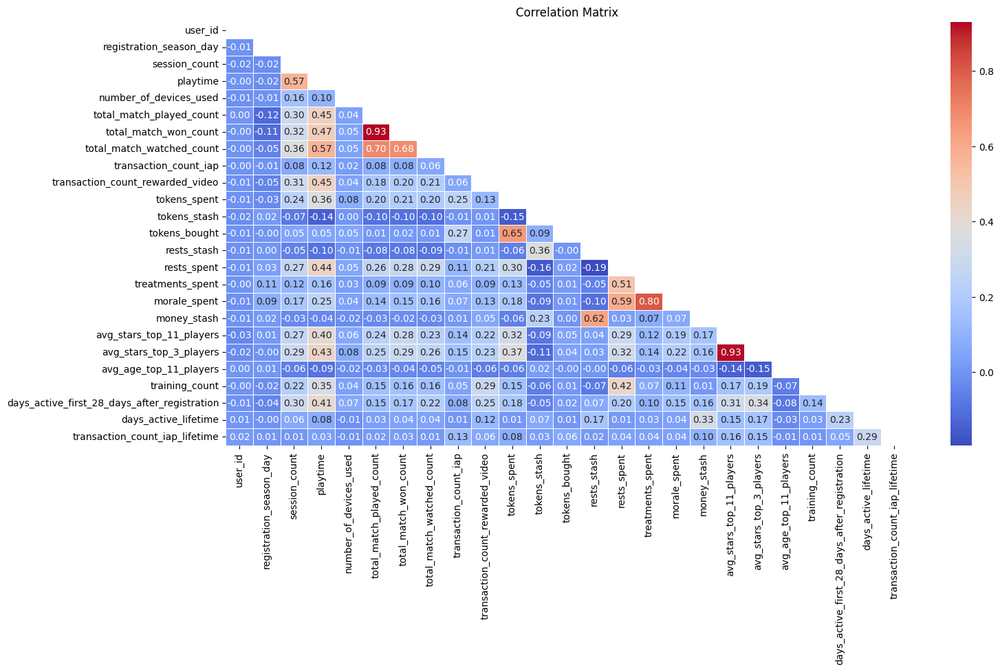

In [83]:
# Correlation Analysis
correlation_matrix = training_data[numeric_columns_training].corr()
plt.figure(figsize=(16, 8))
mask = np.triu(np.ones_like(correlation_matrix, dtype=bool))
sns.heatmap(correlation_matrix, annot=True, mask=mask, cmap='coolwarm', fmt=".2f", linewidths=0.5)
plt.title('Correlation Matrix')
plt.show()

In [84]:
# Identify key correlated pairs (threshold > 0.7 for strong correlation)
correlation_threshold = 0.7
key_correlated_pairs = []

# Iterate over the correlation matrix and find pairs above the threshold
for i in range(correlation_matrix.shape[0]):
    for j in range(i + 1, correlation_matrix.shape[1]):
        if abs(correlation_matrix.iloc[i, j]) > correlation_threshold:
            feature_1 = correlation_matrix.index[i]
            feature_2 = correlation_matrix.columns[j]
            correlation_value = correlation_matrix.iloc[i, j]
            key_correlated_pairs.append((feature_1, feature_2, correlation_value))

# Convert to DataFrame for better readability and display
key_correlated_pairs_df = pd.DataFrame(key_correlated_pairs, columns=["Feature 1", "Feature 2", "Correlation"])
key_correlated_pairs_df = key_correlated_pairs_df.sort_values(by="Correlation", ascending=False).reset_index(drop=True)

key_correlated_pairs_df

,Feature 1,Feature 2,Correlation
0,total_match_played_count,total_match_won_count,0.930722
1,avg_stars_top_11_players,avg_stars_top_3_players,0.925473
2,treatments_spent,morale_spent,0.804064


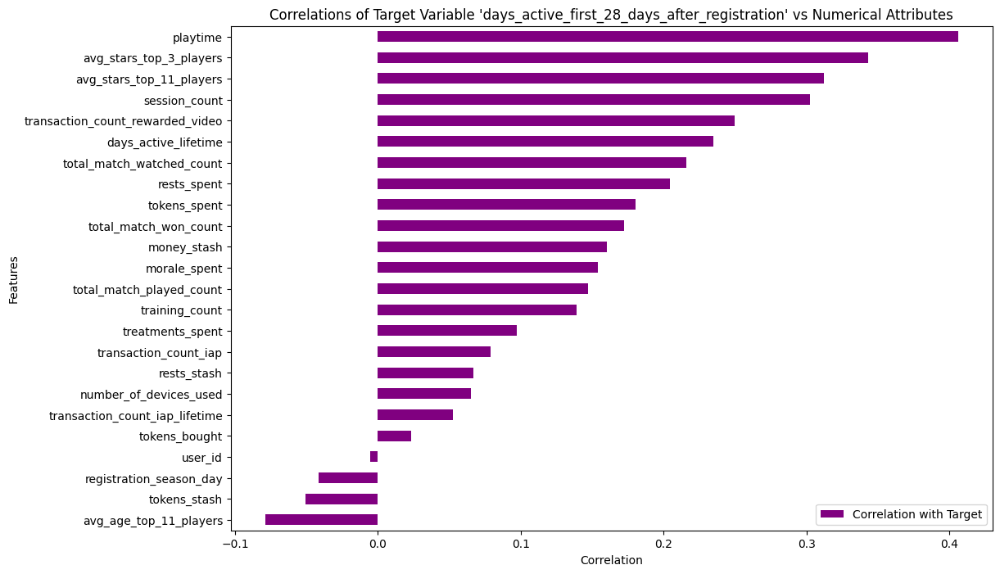

In [85]:
# Extract correlation values between each feature and the target variable 'days_active_first_28_days_after_registration'
target_correlation = correlation_matrix['days_active_first_28_days_after_registration'].drop('days_active_first_28_days_after_registration')

# Sort correlations by absolute value to see the strongest correlations at the top
target_correlation_sorted = target_correlation.sort_values(ascending=True).to_frame(name='Correlation with Target')

# Plotting the correlations
target_correlation_sorted.plot(kind='barh', figsize=(12,8), color='purple')
plt.title("Correlations of Target Variable 'days_active_first_28_days_after_registration' vs Numerical Attributes")
plt.xlabel("Correlation")
plt.ylabel("Features")
plt.show()

In [86]:
# Select only numeric features
numeric_features = training_data.select_dtypes(include=['float64', 'int64']).columns

# Standardize the data for better VIF calculations
scaler = StandardScaler()
scaled_data = scaler.fit_transform(training_data[numeric_features])

# Calculate VIF for each feature
vif_data = pd.DataFrame()
vif_data['Feature'] = numeric_features
vif_data['VIF'] = [variance_inflation_factor(scaled_data, i) for i in range(scaled_data.shape[1])]

# Display features with VIF scores
vif_data.sort_values(by="VIF", ascending=False)

,Feature,VIF
5,total_match_played_count,8.028945
19,avg_stars_top_3_players,7.925343
6,total_match_won_count,7.859023
18,avg_stars_top_11_players,7.198259
16,morale_spent,3.328535
15,treatments_spent,2.919539
10,tokens_spent,2.718079
3,playtime,2.714200
7,total_match_watched_count,2.359985
14,rests_spent,2.307109


In [87]:
target_correlation_sorted.sort_values(by="Correlation with Target", ascending=False)

,Correlation with Target
playtime,0.405866
avg_stars_top_3_players,0.343371
avg_stars_top_11_players,0.312195
session_count,0.302213
transaction_count_rewarded_video,0.249702
days_active_lifetime,0.234768
total_match_watched_count,0.215645
rests_spent,0.204557
tokens_spent,0.180192
total_match_won_count,0.172427


In [88]:
# Drop 'total_match_won_count', 'avg_stars_top_11_players' and'treatments_spent' as they were identified as redundant
training_data = training_data.drop(['total_match_won_count', 'avg_stars_top_11_players', 'treatments_spent'], axis=1)

# Verify the features were dropped successfully
print("Remaining columns:", training_data.columns)

Remaining columns: Index(['user_id', 'registration_time_utc', 'registration_platform_specific',
       'registration_country', 'registration_store', 'registration_season_day',
       'registration_channel_detailed', 'registration_device_type',
       'registration_device_manufacturer', 'session_count', 'playtime',
       'number_of_devices_used', 'total_match_played_count',
       'total_match_watched_count', 'transaction_count_iap',
       'transaction_count_rewarded_video', 'tokens_spent', 'tokens_stash',
       'tokens_bought', 'rests_stash', 'rests_spent', 'morale_spent',
       'money_stash', 'avg_stars_top_3_players', 'avg_age_top_11_players',
       'training_count', 'days_active_first_28_days_after_registration',
       'is_payer_lifetime', 'days_active_lifetime',
       'transaction_count_iap_lifetime', 'is_rewarded_video_watcher_lifetime'],
      dtype='object')


In [89]:
numeric_columns_training = training_data.select_dtypes(include=['int64', 'float64']).columns.tolist()

In [90]:
# Calculate the IQR for each numerical column
Q1 = training_data[numeric_columns_training].quantile(0.25)
Q3 = training_data[numeric_columns_training].quantile(0.75)
IQR = Q3 - Q1

# Define lower and upper bounds for outliers
lower_bound = Q1 - 1.5 * IQR
upper_bound = Q3 + 1.5 * IQR

# Identify potential outliers
outliers = ((training_data[numeric_columns_training] < lower_bound) | (training_data[numeric_columns_training] > upper_bound)).any(axis=1)
outliers.value_counts()

True     28567
False    21433
dtype: int64

In [91]:
# Calculate percentage of outliers for each numerical column in the training dataset
outlier_percentage = {}

# Calculate IQR, bounds, and outlier percentage per column
for col in numeric_columns_training:
    Q1 = training_data[col].quantile(0.25)
    Q3 = training_data[col].quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR
    outliers = ((training_data[col] < lower_bound) | (training_data[col] > upper_bound))
    outlier_percentage[col] = (outliers.sum() / len(training_data)) * 100

# Convert to a DataFrame for easier viewing
outlier_percentage_df = pd.DataFrame(list(outlier_percentage.items()), columns=['Column', 'Outlier Percentage'])
outlier_percentage_df

,Column,Outlier Percentage
0,user_id,0.000
1,registration_season_day,0.000
2,session_count,4.272
3,playtime,5.928
4,number_of_devices_used,1.248
5,total_match_played_count,7.386
6,total_match_watched_count,21.432
7,transaction_count_iap,1.110
8,transaction_count_rewarded_video,15.076
9,tokens_spent,1.206


In [92]:
# Export the merged training and test datasets to CSV
training_data.to_csv(r"C:\Users\User\Projects_for_Competitions_Companies\Nordeus_Data_Science_Challenge_2024\data\processed/merged_training_data.csv", index=False)
test_data.to_csv(r"C:\Users\User\Projects_for_Competitions_Companies\Nordeus_Data_Science_Challenge_2024\data\processed/merged_test_data.csv", index=False)

In [93]:
# Use the power of ydata_profiling library to understand our training data
profile = ProfileReport(training_data, title="Profiling Report")
profile.to_notebook_iframe()
profile.to_file(r"C:\Users\User\Projects_for_Competitions_Companies\Nordeus_Data_Science_Challenge_2024\docs\ydata_training_data.html")
profile.to_file(r"C:\Users\User\Projects_for_Competitions_Companies\Nordeus_Data_Science_Challenge_2024\docs\ydata_training_data.json")

Render HTML: 100%|██████████| 1/1 [00:41<00:00, 41.97s/it]


Export report to file: 100%|██████████| 1/1 [00:00<00:00,  1.67it/s]


Done! Use 'show' commands to display/save.   |██████████| [100%]   00:03 -> (00:00 left)                 


Report C:\Users\User\Projects_for_Competitions_Companies\Nordeus_Data_Science_Challenge_2024\docs\sweetviz_training_data.html was generated! NOTEBOOK/COLAB USERS: the web browser MAY not pop up, regardless, the report IS saved in your notebook/colab files.



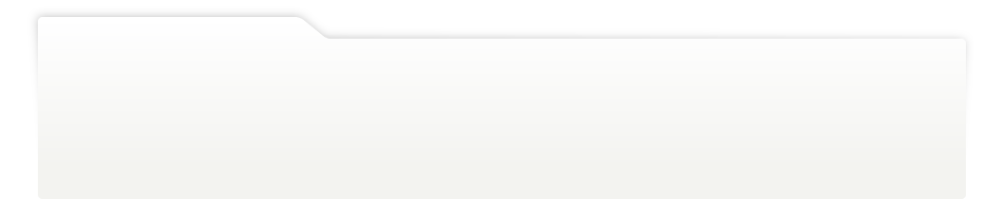
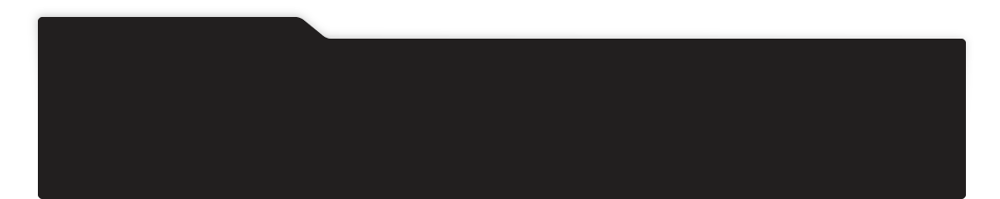
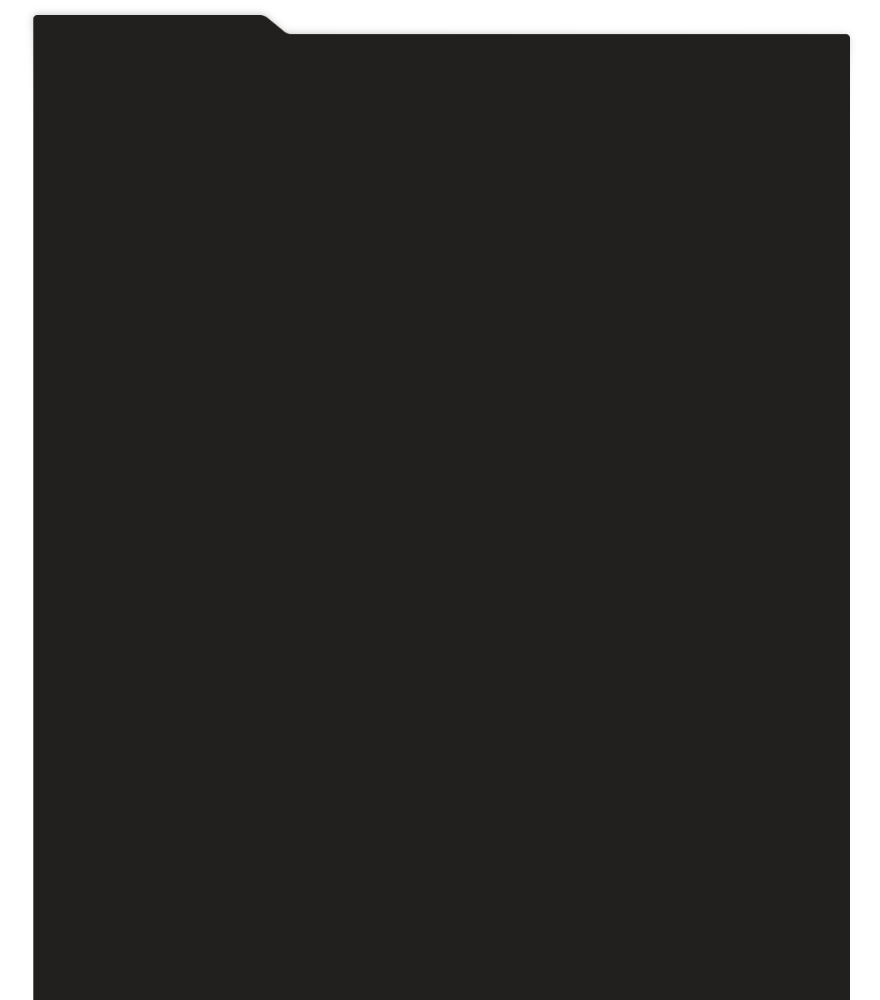
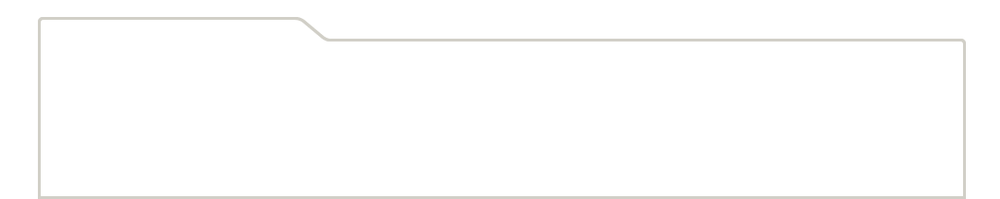
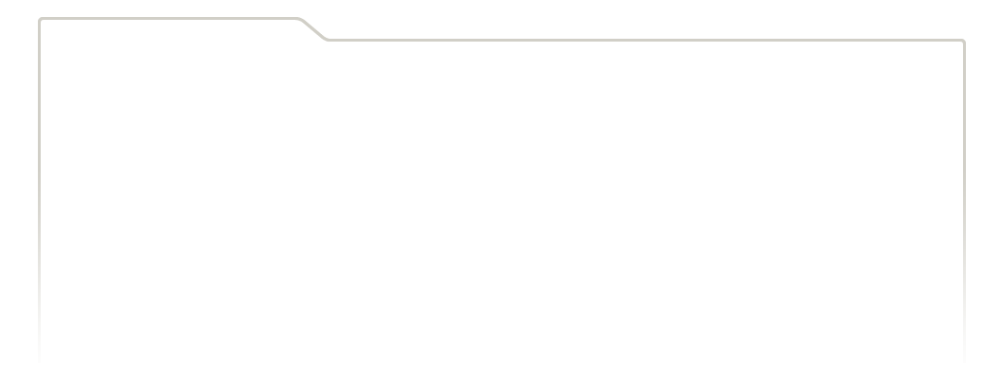
...
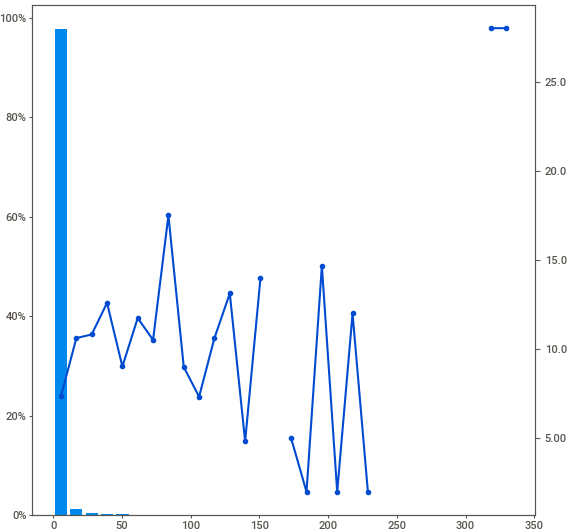
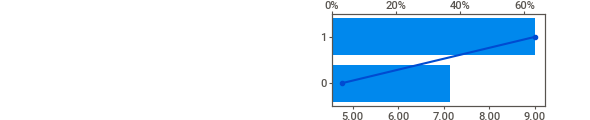
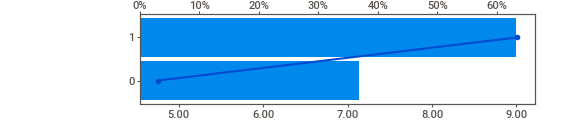
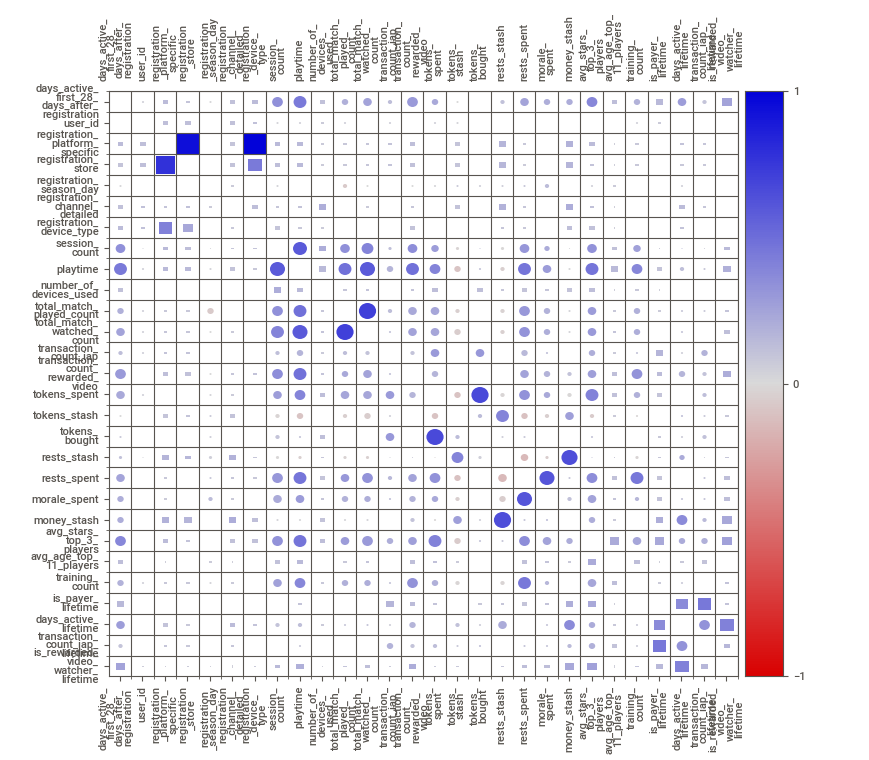
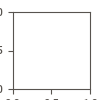

In [94]:
# Use the power of sweetviz library to understand our training data in relevance to the target variable
my_report = sv.analyze(training_data, target_feat='days_active_first_28_days_after_registration')
my_report.show_html(r'C:\Users\User\Projects_for_Competitions_Companies\Nordeus_Data_Science_Challenge_2024\docs\sweetviz_training_data.html')

my_report.show_notebook(w=None,
                h=None,
                scale=None,
                layout='widescreen',
                filepath=None)

In [142]:
# Compare the training and test data
compare = sv.compare(source=training_data, compare=test_data, target_feat="days_active_first_28_days_after_registration")

# Show the result
compare.show_html(r'C:\Users\User\Projects_for_Competitions_Companies\Nordeus_Data_Science_Challenge_2024\docs\sweetviz_compare.html')

compare.show_notebook(w=None,
                h=None,
                scale=None,
                layout='widescreen',
                filepath=None)

Feature: registration_time_utc               |▉         | [  9%]   00:05 -> (00:55 left)                 

ValueError: The truth value of a Series is ambiguous. Use a.empty, a.bool(), a.item(), a.any() or a.all().

In [97]:
# Identify categorical columns for encoding
categorical_columns = training_data.select_dtypes(include=['object']).columns.tolist()
categorical_columns

['registration_platform_specific',
 'registration_country',
 'registration_store',
 'registration_channel_detailed',
 'registration_device_type',
 'registration_device_manufacturer']

In [98]:
# Classify columns based on unique value counts
one_hot_cols = [col for col in categorical_columns if training_data[col].nunique() <= 5]
freq_encode_cols = [col for col in categorical_columns if training_data[col].nunique() > 5]

one_hot_cols, freq_encode_cols

(['registration_channel_detailed', 'registration_device_type'],
 ['registration_platform_specific',
  'registration_country',
  'registration_store',
  'registration_device_manufacturer'])

In [99]:
# Apply One-Hot Encoding for columns with few unique categories
training_data = pd.get_dummies(training_data, columns=one_hot_cols, drop_first=True)

# Apply Frequency Encoding for high-cardinality columns
for col in freq_encode_cols:
    freq_encoding = training_data[col].value_counts() / len(training_data)
    training_data[col] = training_data[col].map(freq_encoding)

In [100]:
# Convert boolean columns from one-hot encoding to integers
bool_columns = training_data.select_dtypes(include=['bool']).columns
training_data[bool_columns] = training_data[bool_columns].astype(int)

In [101]:
training_data.head().T

,0,1,2,3,4
user_id,5,7,13,23,25
registration_time_utc,2024-05-25 01:26:48,2024-06-14 20:09:31,2024-05-31 09:06:51,2024-05-31 04:00:33,2024-06-15 19:56:05
registration_platform_specific,0.2179,0.69598,0.69598,0.69598,0.2179
registration_country,0.03238,0.08944,0.00052,0.24036,0.01456
registration_store,0.24408,0.72034,0.72034,0.72034,0.24408
registration_season_day,7,27,13,13,28
registration_device_manufacturer,0.24136,0.1937,0.1937,0.06238,0.24136
session_count,1,1,2,4,5
playtime,2.351033,8.6959,28.386383,53.028333,97.782017
number_of_devices_used,1,1,1,1,1


In [102]:
# Save the encoded dataset
training_data.to_csv(r"C:\Users\User\Projects_for_Competitions_Companies\Nordeus_Data_Science_Challenge_2024\data\processed\encoded_training_data.csv", index=False)

In [103]:
# Calculate skewness for each numerical column in the training dataset
skewness = training_data.skew(numeric_only=True).sort_values(ascending=False)

# Display skewness values
skewness_df = skewness.to_frame(name='Skewness').reset_index()
skewness_df.columns = ['Feature', 'Skewness']
skewness_df

,Feature,Skewness
0,tokens_bought,167.048339
1,tokens_spent,52.981573
2,transaction_count_iap,22.600050
3,training_count,19.681952
4,tokens_stash,19.657883
5,transaction_count_iap_lifetime,17.238154
6,transaction_count_rewarded_video,6.918834
7,morale_spent,6.863805
8,total_match_watched_count,4.958619
9,total_match_played_count,4.316638


In [104]:
# Define a function to apply transformations based on skewness
def apply_transformations(data, skewed_features):
    transformed_data = data.copy()

    for feature in skewed_features:
        # Apply log transformation for features with extremely high skewness (>20)
        if skewed_features[feature] > 20:
            transformed_data[feature] = np.log1p(transformed_data[feature])  # log1p to handle zeros safely
    return transformed_data

# Identify features to transform based on skewness
skewed_features = {
    'tokens_bought': 167.048339,
    'tokens_spent': 52.981573,
    'transaction_count_iap': 22.600050
}

# Apply transformations based on skewness levels
registration_data_training_transformed = apply_transformations(training_data, skewed_features)

# Check if transformations were applied correctly
print(registration_data_training_transformed[skewed_features.keys()].describe())

       tokens_bought  tokens_spent  transaction_count_iap
count   50000.000000  50000.000000           50000.000000
mean        0.022794      2.186985               0.010595
std         0.306197      1.998812               0.107711
min         0.000000      0.000000               0.000000
25%         0.000000      0.000000               0.000000
50%         0.000000      2.397895               0.000000
75%         0.000000      4.262680               0.000000
max         9.105091      9.125109               2.772589


In [105]:
registration_data_training_transformed.skew(numeric_only=True).sort_values(ascending=False)

training_count                                  19.681952
tokens_stash                                    19.657883
transaction_count_iap_lifetime                  17.238154
tokens_bought                                   14.718797
transaction_count_iap                           11.856628
transaction_count_rewarded_video                 6.918834
morale_spent                                     6.863805
total_match_watched_count                        4.958619
total_match_played_count                         4.316638
registration_channel_detailed_Unknown            4.056813
session_count                                    3.836296
registration_device_type_Tablet                  3.789101
rests_spent                                      3.700693
playtime                                         3.589172
number_of_devices_used                           3.346028
days_active_lifetime                             3.084610
is_payer_lifetime                                2.288751
rests_stash   

In [106]:
# Define the target and features
X = training_data.drop(columns=['days_active_first_28_days_after_registration'], errors='ignore')
y = training_data['days_active_first_28_days_after_registration']

# Remove datetime columns from the feature set
X = X.select_dtypes(exclude=['datetime64[ns]'])

# Initialize the Random Forest Regressor
rf_model = RandomForestRegressor(n_estimators=100, random_state=42)
rf_model.fit(X, y)

# Get feature importance from the Random Forest model
feature_importances = pd.DataFrame({
    'Feature': X.columns,
    'Importance': rf_model.feature_importances_
}).sort_values(by='Importance', ascending=False)

# Initialize RFE with the Random Forest model as the estimator
rfe_selector = RFE(estimator=rf_model, n_features_to_select=20, step=1)
rfe_selector.fit(X, y)

# Get the ranking of features from RFE
rfe_features = pd.DataFrame({
    'Feature': X.columns,
    'RFE_Ranking': rfe_selector.ranking_
}).sort_values(by='RFE_Ranking')

# Merge feature importance and RFE rankings for comparison
feature_selection_summary = pd.merge(feature_importances, rfe_features, on='Feature')

# Display the top 20 features based on both methods
feature_selection_summary.head(20)

,Feature,Importance,RFE_Ranking
0,playtime,0.304712,1
1,days_active_lifetime,0.094327,1
2,money_stash,0.069456,1
3,user_id,0.060412,1
4,rests_stash,0.054985,1
5,avg_stars_top_3_players,0.053701,1
6,tokens_stash,0.046488,1
7,registration_season_day,0.041254,1
8,tokens_spent,0.034585,1
9,registration_country,0.033743,1


In [107]:
# Set the tracking URI
mlflow.set_tracking_uri("file:/C:/Users/User/Projects_for_Competitions_Companies/Nordeus_Data_Science_Challenge_2024/logs")

# Set the experiment name
mlflow.set_experiment("Nordeus_Data_Science_Challenge")

2024/11/13 23:20:52 INFO mlflow.tracking.fluent: Experiment with name 'Nordeus_Data_Science_Challenge' does not exist. Creating a new experiment.


<Experiment: artifact_location='file:///C:/Users/User/Projects_for_Competitions_Companies/Nordeus_Data_Science_Challenge_2024/logs/1', creation_time=1731536452062, experiment_id='1', last_update_time=1731536452062, lifecycle_stage='active', name='Nordeus_Data_Science_Challenge', tags={}>

In [116]:
# Define the selected features from RFE and the target variable
selected_features = [
    'playtime', 'days_active_lifetime', 'money_stash', 'user_id', 'rests_stash',
    'avg_stars_top_3_players', 'tokens_stash', 'registration_season_day', 'tokens_spent',
    'registration_country', 'registration_device_manufacturer', 'training_count',
    'rests_spent', 'session_count', 'transaction_count_rewarded_video', 'morale_spent',
    'avg_age_top_11_players', 'total_match_played_count', 'transaction_count_iap_lifetime'
]
target_variable = 'days_active_first_28_days_after_registration'

# Split the training data into train and validation sets
X = training_data[selected_features]
y = training_data[target_variable]

X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.2, random_state=42)

# Convert target variables to NumPy arrays
y_train = y_train.to_numpy() 
y_val = y_val.to_numpy()

# Initialize MLflow for experiment tracking
mlflow.set_experiment("Nordeus_Data_Science_Challenge")

# Log the split data information
print("Train set size:", X_train.shape, "Validation set size:", X_val.shape)

Train set size: (40000, 19) Validation set size: (10000, 19)


In [117]:
# Initialize StandardScaler
scaler = StandardScaler()

# Fit the scaler on the training data and transform both training and validation sets
X_train_scaled = scaler.fit_transform(X_train)
X_val_scaled = scaler.transform(X_val)

# Verify the scaling by checking the mean and standard deviation of the scaled features
train_mean = X_train_scaled.mean(axis=0)
train_std = X_train_scaled.std(axis=0)

val_mean = X_val_scaled.mean(axis=0)
val_std = X_val_scaled.std(axis=0)

train_mean[:5], train_std[:5], val_mean[:5], val_std[:5]

(array([-7.99360578e-18,  5.29354338e-17,  2.84217094e-18, -2.30926389e-17,
         1.17950094e-16]),
 array([1., 1., 1., 1., 1.]),
 array([ 0.00578303, -0.02432441, -0.00029466, -0.01443401, -0.00975852]),
 array([1.04260047, 0.96178477, 0.99446107, 0.99735394, 0.99995843]))

In [118]:
# Directory path for processed data
processed_data_dir = r"C:\Users\User\Projects_for_Competitions_Companies\Nordeus_Data_Science_Challenge_2024\data\processed"

# Save the scaled training data
with open(os.path.join(processed_data_dir, 'X_train_scaled.pkl'), 'wb') as f:
    pickle.dump(X_train_scaled, f)

# Save the scaled validation data
with open(os.path.join(processed_data_dir, 'X_val_scaled.pkl'), 'wb') as f:
    pickle.dump(X_val_scaled, f)

In [119]:
# Define a dictionary to store model performance
model_results = {}

# Define a helper function to evaluate and log models
def evaluate_model(model, model_name):
    with mlflow.start_run(run_name=model_name):
        # Cross-validate the model
        cv_mae = -cross_val_score(model, X_train_scaled, y_train, cv=5, scoring='neg_mean_absolute_error').mean()

        # Log metrics
        mlflow.log_param("model_name", model_name)
        mlflow.log_metric("MAE", cv_mae)

        # Store results
        model_results[model_name] = {"MAE": cv_mae}

        # Log the model with input example
        mlflow.sklearn.log_model(model, model_name)

    print(f"{model_name}: MAE = {cv_mae:.4f}")

# 1. Linear Regression
linear_model = LinearRegression()
evaluate_model(linear_model, "Linear_Regression")

# 2. Ridge Regression
ridge_model = Ridge(alpha=1.0)
evaluate_model(ridge_model, "Ridge_Regression")

# 3. Lasso Regression
lasso_model = Lasso(alpha=0.1)
evaluate_model(lasso_model, "Lasso_Regression")

# 4. Random Forest Regressor
rf_model = RandomForestRegressor(n_estimators=100, random_state=42)
evaluate_model(rf_model, "Random_Forest")

# 5. XGBoost Regressor
xgb_model = xgb.XGBRegressor(n_estimators=100, random_state=42)
evaluate_model(xgb_model, "XGBoost")

# 6. LightGBM Regressor
lgb_model = lgb.LGBMRegressor(n_estimators=100, random_state=42, force_row_wise=True)
evaluate_model(lgb_model, "LightGBM")

# 7. Initialize the Gradient Boosting Regressor
gbr_model = GradientBoostingRegressor(n_estimators=100, random_state=42)
evaluate_model(gbr_model, "Gradient_Boosting")

Linear_Regression: MAE = 6.4814
Ridge_Regression: MAE = 6.4814
Lasso_Regression: MAE = 6.5286
Random_Forest: MAE = 6.0653
XGBoost: MAE = 5.9294
[LightGBM] [Info] Total Bins 2891
[LightGBM] [Info] Number of data points in the train set: 32000, number of used features: 19
[LightGBM] [Info] Start training from score 7.448719
[LightGBM] [Info] Total Bins 2894
[LightGBM] [Info] Number of data points in the train set: 32000, number of used features: 19
[LightGBM] [Info] Start training from score 7.442625
[LightGBM] [Info] Total Bins 2895
[LightGBM] [Info] Number of data points in the train set: 32000, number of used features: 19
[LightGBM] [Info] Start training from score 7.464531
[LightGBM] [Info] Total Bins 2894
[LightGBM] [Info] Number of data points in the train set: 32000, number of used features: 19
[LightGBM] [Info] Start training from score 7.421219
[LightGBM] [Info] Total Bins 2893
[LightGBM] [Info] Number of data points in the train set: 32000, number of used features: 19
[LightGBM

In [120]:
# Define base models for ensemble methods
base_models = [
    ("Random_Forest", rf_model),
    ("XGBoost", xgb_model),
    ("LightGBM", lgb_model),
    ("Gradient_Boosting", gbr_model)
]

# 8. Voting Regressor (Ensemble of Tree-Based Models)
voting_regressor = VotingRegressor(estimators=base_models)
evaluate_model(voting_regressor, "Voting_Regressor")

# 9. Stacking Regressor (Ensemble of Tree-Based Models and Linear Regression)
stacking_regressor = StackingRegressor(
    estimators=base_models,
    final_estimator=LinearRegression()
)
evaluate_model(stacking_regressor, "Stacking_Regressor")

[LightGBM] [Info] Total Bins 2891
[LightGBM] [Info] Number of data points in the train set: 32000, number of used features: 19
[LightGBM] [Info] Start training from score 7.448719
[LightGBM] [Info] Total Bins 2894
[LightGBM] [Info] Number of data points in the train set: 32000, number of used features: 19
[LightGBM] [Info] Start training from score 7.442625
[LightGBM] [Info] Total Bins 2895
[LightGBM] [Info] Number of data points in the train set: 32000, number of used features: 19
[LightGBM] [Info] Start training from score 7.464531
[LightGBM] [Info] Total Bins 2894
[LightGBM] [Info] Number of data points in the train set: 32000, number of used features: 19
[LightGBM] [Info] Start training from score 7.421219
[LightGBM] [Info] Total Bins 2893
[LightGBM] [Info] Number of data points in the train set: 32000, number of used features: 19
[LightGBM] [Info] Start training from score 7.438656
Voting_Regressor: MAE = 5.8893
[LightGBM] [Info] Total Bins 2891
[LightGBM] [Info] Number of data po

2024/11/14 01:46:00 WARNING mlflow.sklearn: Model was missing function: predict. Not logging python_function flavor!


Stacking_Regressor: MAE = 5.8493


In [121]:
# Display the updated model results after ensemble model training
model_results

{'Linear_Regression': {'MAE': 6.48135860199544},
 'Ridge_Regression': {'MAE': 6.481377871334391},
 'Lasso_Regression': {'MAE': 6.5286227373304},
 'Random_Forest': {'MAE': 6.0652574999999995},
 'XGBoost': {'MAE': 5.9293717690138},
 'LightGBM': {'MAE': 5.842091454793788},
 'Gradient_Boosting': {'MAE': 5.909384502210857},
 'Voting_Regressor': {'MAE': 5.889296212379142},
 'Stacking_Regressor': {'MAE': 5.849282805063275}}

In [122]:
# Define a helper function to evaluate deep learning models
def evaluate_dl_model(model, model_name, X_train, y_train, X_val, y_val):
    with mlflow.start_run(run_name=model_name):
        # Compile the model
        model.compile(optimizer=Adam(learning_rate=0.001), loss='mean_absolute_error')

        # Train the model
        history = model.fit(X_train, y_train, validation_data=(X_val, y_val), epochs=50, batch_size=32, verbose=0)

        # Make predictions on the validation set
        y_pred = model.predict(X_val)

        # Calculate metrics
        mae = mean_absolute_error(y_val, y_pred)

        # Log metrics to MLflow
        mlflow.log_param("model_name", model_name)
        mlflow.log_metric("MAE", mae)

        # Log the model
        mlflow.keras.log_model(model, model_name)

        print(f"{model_name}: MAE = {mae:.4f}")

# Define a Feedforward Neural Network model
def build_ffnn(input_dim):
    model = Sequential([
        Input(shape=(input_dim,)),
        Dense(128, activation='relu'),
        Dropout(0.3),
        Dense(64, activation='relu'),
        Dropout(0.3),
        Dense(32, activation='relu'),
        Dense(1)
    ])
    return model

# Build and evaluate the Feedforward Neural Network model
input_dim = X_train_scaled.shape[1]
ffnn_model = build_ffnn(input_dim)
evaluate_dl_model(ffnn_model, "Feedforward_Neural_Network", X_train_scaled, y_train, X_val_scaled, y_val)

Instructions for updating:
If using Keras pass *_constraint arguments to layers.
INFO:tensorflow:Assets written to: C:\Users\User\AppData\Local\Temp\tmpnxgakijd\model\data\model\assets
Feedforward_Neural_Network: MAE = 5.4536


In [123]:
# Define an objective function for the Feedforward Neural Network
def objective_ffnn(trial):
    # Hyperparameter suggestions
    n_layers = trial.suggest_int("n_layers", 2, 4)
    n_neurons = trial.suggest_int("n_neurons", 32, 256)
    dropout_rate = trial.suggest_float("dropout_rate", 0.1, 0.5)
    learning_rate = trial.suggest_float("learning_rate", 1e-5, 1e-2)
    epochs = trial.suggest_int("epochs", 20, 100)
    batch_size = trial.suggest_int("batch_size", 16, 64)

    # Build the model
    model = Sequential()
    model.add(Input(shape=(X_train_scaled.shape[1],)))
    model.add(Dense(n_neurons, activation='relu'))
    model.add(Dropout(dropout_rate))
    for _ in range(n_layers - 1):
        model.add(Dense(n_neurons, activation='relu'))
        model.add(Dropout(dropout_rate))
    model.add(Dense(1))  # Output layer

    # Compile the model
    optimizer = Adam(learning_rate=learning_rate)
    model.compile(optimizer=optimizer, loss='mean_absolute_error')

    # Train the model
    history = model.fit(X_train_scaled, y_train, validation_data=(X_val_scaled, y_val),
                        epochs=epochs, batch_size=batch_size, verbose=0)

    # Evaluate the model
    y_pred = model.predict(X_val_scaled).flatten()
    mae = mean_absolute_error(y_val, y_pred)

    return mae

In [124]:
# Define the objective function for LightGBM tuning
def objective_lgb(trial):
    param = {
        "n_estimators": trial.suggest_int("n_estimators", 200, 1200),
        "learning_rate": trial.suggest_float("learning_rate", 0.005, 0.05),
        "num_leaves": trial.suggest_int("num_leaves", 20, 150),
        "max_depth": trial.suggest_int("max_depth", 3, 15),
        "min_child_samples": trial.suggest_int("min_child_samples", 10, 40),
        "min_gain_to_split": trial.suggest_float("min_gain_to_split", 0.01, 0.1),
        "subsample": trial.suggest_float("subsample", 0.6, 0.9),
        "colsample_bytree": trial.suggest_float("colsample_bytree", 0.6, 0.9),
        "lambda_l1": trial.suggest_float("lambda_l1", 0.0, 10.0),
        "lambda_l2": trial.suggest_float("lambda_l2", 0.0, 10.0),
        "random_state": 42,
        "force_row_wise": True,
        "verbosity": -1,
    }

    # Initialize and train the model
    model = lgb.LGBMRegressor(**param)
    model.fit(
      X_train, y_train,
      eval_set=[(X_val, y_val)],
      callbacks=[lgb.early_stopping(stopping_rounds=100), lgb.log_evaluation(-1)]
    )

    # Predict and evaluate
    y_pred = model.predict(X_val)
    mae = mean_absolute_error(y_val, y_pred)

    return mae

In [125]:
# Initialize MLflow experiment
mlflow.set_experiment("Optuna_Hyperparameter_Tuning")

# Run Bayesian Optimization with Optuna for Feedforward Neural Network
sampler = optuna.samplers.RandomSampler()
ffnn_study = optuna.create_study(direction="minimize", sampler=sampler)
ffnn_study.optimize(objective_ffnn, n_trials=50)

# Log the best FFNN model parameters
mlflow.log_params(ffnn_study.best_params)
mlflow.log_metric("Best_MAE_FFNN", ffnn_study.best_value)

2024/11/14 01:49:48 INFO mlflow.tracking.fluent: Experiment with name 'Optuna_Hyperparameter_Tuning' does not exist. Creating a new experiment.
[I 2024-11-14 01:49:48,340] A new study created in memory with name: no-name-f807af01-c66d-4859-9052-d63f74400f44
[I 2024-11-14 01:55:03,191] Trial 0 finished with value: 5.473494223841466 and parameters: {'n_layers': 3, 'n_neurons': 102, 'dropout_rate': 0.3322054787464326, 'learning_rate': 0.00997557600067897, 'epochs': 86, 'batch_size': 46}. Best is trial 0 with value: 5.473494223841466.
[I 2024-11-14 01:57:17,788] Trial 1 finished with value: 5.4731234578598755 and parameters: {'n_layers': 3, 'n_neurons': 142, 'dropout_rate': 0.42922019343341644, 'learning_rate': 0.006029759538309573, 'epochs': 37, 'batch_size': 61}. Best is trial 1 with value: 5.4731234578598755.
[I 2024-11-14 02:02:08,674] Trial 2 finished with value: 5.43510370746525 and parameters: {'n_layers': 3, 'n_neurons': 154, 'dropout_rate': 0.34524121163005506, 'learning_rate': 0.

In [126]:
# Run Bayesian Optimization with Optuna for LightGBM model
sampler = optuna.samplers.RandomSampler()
lgb_study = optuna.create_study(direction="minimize", sampler=sampler)
lgb_study.optimize(objective_lgb, n_trials=100)

# Print the best parameters
print("Best MAE:", lgb_study.best_value)
print("Best parameters:", lgb_study.best_params)

[I 2024-11-14 08:12:49,811] A new study created in memory with name: no-name-964c49a5-9d22-4561-aa49-065876cd0cc3


Training until validation scores don't improve for 100 rounds
Early stopping, best iteration is:
[169]	valid_0's l2: 61.6414


[I 2024-11-14 08:13:00,921] Trial 0 finished with value: 5.810448627199025 and parameters: {'n_estimators': 606, 'learning_rate': 0.03806491525228148, 'num_leaves': 89, 'max_depth': 10, 'min_child_samples': 11, 'min_gain_to_split': 0.05231826044041824, 'subsample': 0.6747375841883892, 'colsample_bytree': 0.6506131555392142, 'lambda_l1': 7.4131953264231285, 'lambda_l2': 1.315136377214523}. Best is trial 0 with value: 5.810448627199025.


Training until validation scores don't improve for 100 rounds
Early stopping, best iteration is:
[545]	valid_0's l2: 61.6769


[I 2024-11-14 08:13:07,839] Trial 1 finished with value: 5.809071705014676 and parameters: {'n_estimators': 880, 'learning_rate': 0.015025664825737143, 'num_leaves': 50, 'max_depth': 15, 'min_child_samples': 12, 'min_gain_to_split': 0.043028649781631095, 'subsample': 0.6219967192497659, 'colsample_bytree': 0.8322910970932494, 'lambda_l1': 1.648946765307856, 'lambda_l2': 6.97768467510388}. Best is trial 1 with value: 5.809071705014676.


Training until validation scores don't improve for 100 rounds
Early stopping, best iteration is:
[144]	valid_0's l2: 61.9329


[I 2024-11-14 08:13:13,128] Trial 2 finished with value: 5.823696216127141 and parameters: {'n_estimators': 970, 'learning_rate': 0.03419078995755574, 'num_leaves': 132, 'max_depth': 9, 'min_child_samples': 12, 'min_gain_to_split': 0.03951611068433157, 'subsample': 0.7690729554074486, 'colsample_bytree': 0.8478598335548815, 'lambda_l1': 3.954925911246204, 'lambda_l2': 9.069065513645526}. Best is trial 1 with value: 5.809071705014676.


Training until validation scores don't improve for 100 rounds


[I 2024-11-14 08:13:17,622] Trial 3 finished with value: 5.802334254330936 and parameters: {'n_estimators': 1074, 'learning_rate': 0.044677102471254386, 'num_leaves': 39, 'max_depth': 9, 'min_child_samples': 29, 'min_gain_to_split': 0.022898845954329762, 'subsample': 0.6427843914091261, 'colsample_bytree': 0.8378340040431339, 'lambda_l1': 5.271295142849615, 'lambda_l2': 7.461449256281797}. Best is trial 3 with value: 5.802334254330936.


Early stopping, best iteration is:
[191]	valid_0's l2: 61.5417
Training until validation scores don't improve for 100 rounds
Early stopping, best iteration is:
[400]	valid_0's l2: 61.7146


[I 2024-11-14 08:13:24,309] Trial 4 finished with value: 5.798259951699957 and parameters: {'n_estimators': 1155, 'learning_rate': 0.01810064383104307, 'num_leaves': 89, 'max_depth': 11, 'min_child_samples': 32, 'min_gain_to_split': 0.03132999597296251, 'subsample': 0.7242041539921945, 'colsample_bytree': 0.7719202154679403, 'lambda_l1': 9.273752277454454, 'lambda_l2': 8.019826028093892}. Best is trial 4 with value: 5.798259951699957.


Training until validation scores don't improve for 100 rounds
Early stopping, best iteration is:
[294]	valid_0's l2: 61.6183


[I 2024-11-14 08:13:27,034] Trial 5 finished with value: 5.8141758491506605 and parameters: {'n_estimators': 1024, 'learning_rate': 0.0376830622646253, 'num_leaves': 86, 'max_depth': 5, 'min_child_samples': 25, 'min_gain_to_split': 0.08392972502499582, 'subsample': 0.7227936627049034, 'colsample_bytree': 0.7555014635889394, 'lambda_l1': 4.144720725273491, 'lambda_l2': 1.4955251551465887}. Best is trial 4 with value: 5.798259951699957.


Training until validation scores don't improve for 100 rounds
Early stopping, best iteration is:
[192]	valid_0's l2: 61.7855


[I 2024-11-14 08:13:31,995] Trial 6 finished with value: 5.796747832929719 and parameters: {'n_estimators': 598, 'learning_rate': 0.033779261227837726, 'num_leaves': 147, 'max_depth': 10, 'min_child_samples': 23, 'min_gain_to_split': 0.08250772538145511, 'subsample': 0.6620402333861821, 'colsample_bytree': 0.6639455581745715, 'lambda_l1': 9.175357133617268, 'lambda_l2': 1.6778616761300924}. Best is trial 6 with value: 5.796747832929719.


Training until validation scores don't improve for 100 rounds
Early stopping, best iteration is:
[443]	valid_0's l2: 61.4665


[I 2024-11-14 08:13:34,861] Trial 7 finished with value: 5.81439858126151 and parameters: {'n_estimators': 886, 'learning_rate': 0.03467299740756897, 'num_leaves': 30, 'max_depth': 4, 'min_child_samples': 34, 'min_gain_to_split': 0.06163960571796523, 'subsample': 0.7962893923783407, 'colsample_bytree': 0.8568207875182289, 'lambda_l1': 1.008776715440074, 'lambda_l2': 6.8278768788137745}. Best is trial 6 with value: 5.796747832929719.


Training until validation scores don't improve for 100 rounds
Did not meet early stopping. Best iteration is:
[553]	valid_0's l2: 61.4651


[I 2024-11-14 08:13:37,551] Trial 8 finished with value: 5.826494244289502 and parameters: {'n_estimators': 619, 'learning_rate': 0.0449521621008269, 'num_leaves': 102, 'max_depth': 3, 'min_child_samples': 33, 'min_gain_to_split': 0.031044921959786753, 'subsample': 0.8958898221866634, 'colsample_bytree': 0.7226936399489657, 'lambda_l1': 7.112836716007486, 'lambda_l2': 7.140636600761864}. Best is trial 6 with value: 5.796747832929719.


Training until validation scores don't improve for 100 rounds


[I 2024-11-14 08:13:40,290] Trial 9 finished with value: 5.804971554568081 and parameters: {'n_estimators': 1016, 'learning_rate': 0.039510031374811246, 'num_leaves': 39, 'max_depth': 11, 'min_child_samples': 28, 'min_gain_to_split': 0.08997946888588827, 'subsample': 0.8870349557924398, 'colsample_bytree': 0.8718744982721345, 'lambda_l1': 3.4482133446231886, 'lambda_l2': 1.3032600666736216}. Best is trial 6 with value: 5.796747832929719.


Early stopping, best iteration is:
[204]	valid_0's l2: 61.6554
Training until validation scores don't improve for 100 rounds
Early stopping, best iteration is:
[353]	valid_0's l2: 61.6787


[I 2024-11-14 08:13:45,871] Trial 10 finished with value: 5.804480200559507 and parameters: {'n_estimators': 636, 'learning_rate': 0.021991639496715846, 'num_leaves': 69, 'max_depth': 7, 'min_child_samples': 34, 'min_gain_to_split': 0.020103105772036618, 'subsample': 0.7006987934822781, 'colsample_bytree': 0.8110934438709709, 'lambda_l1': 2.2415072438332584, 'lambda_l2': 5.412408074999316}. Best is trial 6 with value: 5.796747832929719.


Training until validation scores don't improve for 100 rounds


[I 2024-11-14 08:13:49,439] Trial 11 finished with value: 5.861089658771049 and parameters: {'n_estimators': 304, 'learning_rate': 0.042969406640609296, 'num_leaves': 138, 'max_depth': 12, 'min_child_samples': 10, 'min_gain_to_split': 0.09067126121486671, 'subsample': 0.7897008150693741, 'colsample_bytree': 0.8987704608227294, 'lambda_l1': 3.2728416704341, 'lambda_l2': 1.7018720941984744}. Best is trial 6 with value: 5.796747832929719.


Early stopping, best iteration is:
[89]	valid_0's l2: 62.181
Training until validation scores don't improve for 100 rounds


[I 2024-11-14 08:13:52,016] Trial 12 finished with value: 5.829377899456522 and parameters: {'n_estimators': 281, 'learning_rate': 0.045228321704066016, 'num_leaves': 89, 'max_depth': 9, 'min_child_samples': 12, 'min_gain_to_split': 0.019077011988849556, 'subsample': 0.609957615295423, 'colsample_bytree': 0.701263453110896, 'lambda_l1': 2.5814409491723103, 'lambda_l2': 6.016656269225105}. Best is trial 6 with value: 5.796747832929719.


Early stopping, best iteration is:
[111]	valid_0's l2: 61.8065
Training until validation scores don't improve for 100 rounds
Did not meet early stopping. Best iteration is:
[413]	valid_0's l2: 61.612


[I 2024-11-14 08:13:55,787] Trial 13 finished with value: 5.816045774669373 and parameters: {'n_estimators': 485, 'learning_rate': 0.023106586387991547, 'num_leaves': 29, 'max_depth': 12, 'min_child_samples': 13, 'min_gain_to_split': 0.052566358817156614, 'subsample': 0.8491126571096439, 'colsample_bytree': 0.7074785357670572, 'lambda_l1': 1.4137550534379928, 'lambda_l2': 2.725682396492781}. Best is trial 6 with value: 5.796747832929719.


Training until validation scores don't improve for 100 rounds
Early stopping, best iteration is:
[297]	valid_0's l2: 61.8919


[I 2024-11-14 08:14:01,244] Trial 14 finished with value: 5.807718642613771 and parameters: {'n_estimators': 910, 'learning_rate': 0.02351585116551833, 'num_leaves': 94, 'max_depth': 13, 'min_child_samples': 16, 'min_gain_to_split': 0.07837444880568821, 'subsample': 0.6420519347381378, 'colsample_bytree': 0.8735686363759052, 'lambda_l1': 3.61773484622172, 'lambda_l2': 3.8036831232477866}. Best is trial 6 with value: 5.796747832929719.


Training until validation scores don't improve for 100 rounds
Early stopping, best iteration is:
[371]	valid_0's l2: 61.4521


[I 2024-11-14 08:14:04,320] Trial 15 finished with value: 5.7990653181902445 and parameters: {'n_estimators': 1003, 'learning_rate': 0.03682507371476501, 'num_leaves': 116, 'max_depth': 5, 'min_child_samples': 27, 'min_gain_to_split': 0.013913051343428344, 'subsample': 0.7829422015308072, 'colsample_bytree': 0.8888499097341376, 'lambda_l1': 0.5580592666531459, 'lambda_l2': 9.18575543871194}. Best is trial 6 with value: 5.796747832929719.


Training until validation scores don't improve for 100 rounds
Early stopping, best iteration is:
[486]	valid_0's l2: 61.5694


[I 2024-11-14 08:14:09,119] Trial 16 finished with value: 5.809593408332321 and parameters: {'n_estimators': 1123, 'learning_rate': 0.01902858504794236, 'num_leaves': 35, 'max_depth': 15, 'min_child_samples': 12, 'min_gain_to_split': 0.08712462277564736, 'subsample': 0.6040644585758868, 'colsample_bytree': 0.702043278290089, 'lambda_l1': 4.547827745418297, 'lambda_l2': 6.919659502026869}. Best is trial 6 with value: 5.796747832929719.


Training until validation scores don't improve for 100 rounds
Early stopping, best iteration is:
[241]	valid_0's l2: 61.6465


[I 2024-11-14 08:14:12,075] Trial 17 finished with value: 5.810085424681864 and parameters: {'n_estimators': 733, 'learning_rate': 0.03297944711256741, 'num_leaves': 76, 'max_depth': 6, 'min_child_samples': 18, 'min_gain_to_split': 0.053411806613708514, 'subsample': 0.64589615034941, 'colsample_bytree': 0.8740180386612169, 'lambda_l1': 6.824070470495336, 'lambda_l2': 4.378881702187765}. Best is trial 6 with value: 5.796747832929719.


Training until validation scores don't improve for 100 rounds


[I 2024-11-14 08:14:15,270] Trial 18 finished with value: 5.804086492263784 and parameters: {'n_estimators': 910, 'learning_rate': 0.04917651337155194, 'num_leaves': 49, 'max_depth': 13, 'min_child_samples': 17, 'min_gain_to_split': 0.03869917188099766, 'subsample': 0.715167469899483, 'colsample_bytree': 0.7724164752842146, 'lambda_l1': 1.071109009410176, 'lambda_l2': 3.4391090731342233}. Best is trial 6 with value: 5.796747832929719.


Early stopping, best iteration is:
[177]	valid_0's l2: 61.6895
Training until validation scores don't improve for 100 rounds


[I 2024-11-14 08:14:18,080] Trial 19 finished with value: 5.8090960642969005 and parameters: {'n_estimators': 418, 'learning_rate': 0.034468190295419684, 'num_leaves': 32, 'max_depth': 9, 'min_child_samples': 30, 'min_gain_to_split': 0.023935518687457462, 'subsample': 0.6342836189028723, 'colsample_bytree': 0.6087598701978881, 'lambda_l1': 3.0864879553546, 'lambda_l2': 0.4144679944773133}. Best is trial 6 with value: 5.796747832929719.


Early stopping, best iteration is:
[258]	valid_0's l2: 61.4819
Training until validation scores don't improve for 100 rounds
Early stopping, best iteration is:
[230]	valid_0's l2: 61.7166


[I 2024-11-14 08:14:21,884] Trial 20 finished with value: 5.814484368733035 and parameters: {'n_estimators': 564, 'learning_rate': 0.026171582938905112, 'num_leaves': 74, 'max_depth': 7, 'min_child_samples': 13, 'min_gain_to_split': 0.058191470783758595, 'subsample': 0.7619529316509235, 'colsample_bytree': 0.8750437187613667, 'lambda_l1': 5.993911343794528, 'lambda_l2': 6.469234737117158}. Best is trial 6 with value: 5.796747832929719.


Training until validation scores don't improve for 100 rounds


[I 2024-11-14 08:14:24,845] Trial 21 finished with value: 5.858568189495531 and parameters: {'n_estimators': 713, 'learning_rate': 0.042861697427040914, 'num_leaves': 106, 'max_depth': 11, 'min_child_samples': 23, 'min_gain_to_split': 0.09252324913505297, 'subsample': 0.8437461932449334, 'colsample_bytree': 0.7338510747741283, 'lambda_l1': 7.834041407622752, 'lambda_l2': 0.08140702286179802}. Best is trial 6 with value: 5.796747832929719.


Early stopping, best iteration is:
[96]	valid_0's l2: 62.0193
Training until validation scores don't improve for 100 rounds
Early stopping, best iteration is:
[240]	valid_0's l2: 61.6403


[I 2024-11-14 08:14:28,029] Trial 22 finished with value: 5.800787860685457 and parameters: {'n_estimators': 1027, 'learning_rate': 0.043779386331095, 'num_leaves': 59, 'max_depth': 15, 'min_child_samples': 16, 'min_gain_to_split': 0.010752390736128364, 'subsample': 0.7453251220185922, 'colsample_bytree': 0.6979575605500065, 'lambda_l1': 1.0003457933859516, 'lambda_l2': 4.869965222802123}. Best is trial 6 with value: 5.796747832929719.


Training until validation scores don't improve for 100 rounds
Early stopping, best iteration is:
[184]	valid_0's l2: 61.7123


[I 2024-11-14 08:14:31,797] Trial 23 finished with value: 5.82225946509576 and parameters: {'n_estimators': 1024, 'learning_rate': 0.030638141937222103, 'num_leaves': 109, 'max_depth': 7, 'min_child_samples': 17, 'min_gain_to_split': 0.02403868199099103, 'subsample': 0.7057815976259552, 'colsample_bytree': 0.7028497916934833, 'lambda_l1': 2.240941125451188, 'lambda_l2': 3.6227857326110904}. Best is trial 6 with value: 5.796747832929719.


Training until validation scores don't improve for 100 rounds
Early stopping, best iteration is:
[665]	valid_0's l2: 61.4406


[I 2024-11-14 08:14:36,967] Trial 24 finished with value: 5.796068946304935 and parameters: {'n_estimators': 930, 'learning_rate': 0.022246632932955906, 'num_leaves': 22, 'max_depth': 11, 'min_child_samples': 23, 'min_gain_to_split': 0.024976974704704058, 'subsample': 0.7184697448038816, 'colsample_bytree': 0.6998166259225636, 'lambda_l1': 7.607450808494133, 'lambda_l2': 2.6949824086244565}. Best is trial 24 with value: 5.796068946304935.


Training until validation scores don't improve for 100 rounds


[I 2024-11-14 08:14:39,657] Trial 25 finished with value: 5.797934014983356 and parameters: {'n_estimators': 634, 'learning_rate': 0.044574832090543796, 'num_leaves': 34, 'max_depth': 11, 'min_child_samples': 25, 'min_gain_to_split': 0.0237524123629921, 'subsample': 0.6700650455193816, 'colsample_bytree': 0.8775049503361806, 'lambda_l1': 0.5726012763631105, 'lambda_l2': 4.461622565340443}. Best is trial 24 with value: 5.796068946304935.


Early stopping, best iteration is:
[243]	valid_0's l2: 61.6076
Training until validation scores don't improve for 100 rounds
Did not meet early stopping. Best iteration is:
[202]	valid_0's l2: 62.8389


[I 2024-11-14 08:14:44,661] Trial 26 finished with value: 6.098576552179841 and parameters: {'n_estimators': 202, 'learning_rate': 0.009995967300911436, 'num_leaves': 129, 'max_depth': 12, 'min_child_samples': 20, 'min_gain_to_split': 0.014866095620355367, 'subsample': 0.7230035703054952, 'colsample_bytree': 0.7920668875432302, 'lambda_l1': 5.769621636246168, 'lambda_l2': 7.159584035488333}. Best is trial 24 with value: 5.796068946304935.


Training until validation scores don't improve for 100 rounds
Did not meet early stopping. Best iteration is:
[359]	valid_0's l2: 61.6913


[I 2024-11-14 08:14:50,578] Trial 27 finished with value: 5.8336267740875964 and parameters: {'n_estimators': 359, 'learning_rate': 0.013825816724108826, 'num_leaves': 129, 'max_depth': 13, 'min_child_samples': 17, 'min_gain_to_split': 0.025307086889250607, 'subsample': 0.7326228102869374, 'colsample_bytree': 0.6050295585324852, 'lambda_l1': 2.54209733869733, 'lambda_l2': 9.843832287576129}. Best is trial 24 with value: 5.796068946304935.


Training until validation scores don't improve for 100 rounds


[I 2024-11-14 08:14:53,197] Trial 28 finished with value: 5.806865547754106 and parameters: {'n_estimators': 256, 'learning_rate': 0.04702941803799398, 'num_leaves': 51, 'max_depth': 12, 'min_child_samples': 37, 'min_gain_to_split': 0.01476070117476224, 'subsample': 0.6386368537315453, 'colsample_bytree': 0.7642113488000501, 'lambda_l1': 3.796567507538202, 'lambda_l2': 1.1509300983772286}. Best is trial 24 with value: 5.796068946304935.


Did not meet early stopping. Best iteration is:
[157]	valid_0's l2: 61.6935
Training until validation scores don't improve for 100 rounds
Early stopping, best iteration is:
[553]	valid_0's l2: 61.8416


[I 2024-11-14 08:15:04,023] Trial 29 finished with value: 5.8318832218022605 and parameters: {'n_estimators': 937, 'learning_rate': 0.007991923711854282, 'num_leaves': 114, 'max_depth': 12, 'min_child_samples': 39, 'min_gain_to_split': 0.07449086377176894, 'subsample': 0.6058386925732769, 'colsample_bytree': 0.8647542881086382, 'lambda_l1': 8.946768076897055, 'lambda_l2': 7.995664782031836}. Best is trial 24 with value: 5.796068946304935.


Training until validation scores don't improve for 100 rounds
Early stopping, best iteration is:
[251]	valid_0's l2: 61.6925


[I 2024-11-14 08:15:06,981] Trial 30 finished with value: 5.805721194874044 and parameters: {'n_estimators': 853, 'learning_rate': 0.03594099830060246, 'num_leaves': 102, 'max_depth': 6, 'min_child_samples': 28, 'min_gain_to_split': 0.05510222200732214, 'subsample': 0.8623637710495127, 'colsample_bytree': 0.862952293580078, 'lambda_l1': 9.491576639749118, 'lambda_l2': 1.2845037648549507}. Best is trial 24 with value: 5.796068946304935.


Training until validation scores don't improve for 100 rounds
Did not meet early stopping. Best iteration is:
[1031]	valid_0's l2: 61.614


[I 2024-11-14 08:15:13,620] Trial 31 finished with value: 5.838082918534958 and parameters: {'n_estimators': 1031, 'learning_rate': 0.008936437003976883, 'num_leaves': 117, 'max_depth': 4, 'min_child_samples': 12, 'min_gain_to_split': 0.08378297556829496, 'subsample': 0.7846998284464831, 'colsample_bytree': 0.6856974956948519, 'lambda_l1': 2.4556012178541864, 'lambda_l2': 8.793105155170412}. Best is trial 24 with value: 5.796068946304935.


Training until validation scores don't improve for 100 rounds
Early stopping, best iteration is:
[349]	valid_0's l2: 61.5327


[I 2024-11-14 08:15:18,054] Trial 32 finished with value: 5.79311244019711 and parameters: {'n_estimators': 802, 'learning_rate': 0.030839801038114567, 'num_leaves': 47, 'max_depth': 10, 'min_child_samples': 37, 'min_gain_to_split': 0.0596555194246486, 'subsample': 0.8999895407529053, 'colsample_bytree': 0.6470616778845254, 'lambda_l1': 8.062329576881536, 'lambda_l2': 7.50604108202414}. Best is trial 32 with value: 5.79311244019711.


Training until validation scores don't improve for 100 rounds
Early stopping, best iteration is:
[539]	valid_0's l2: 61.7683


[I 2024-11-14 08:15:27,563] Trial 33 finished with value: 5.813442329092706 and parameters: {'n_estimators': 1041, 'learning_rate': 0.01017764566169152, 'num_leaves': 135, 'max_depth': 8, 'min_child_samples': 31, 'min_gain_to_split': 0.06913050064652479, 'subsample': 0.8343433679524405, 'colsample_bytree': 0.8191438580944249, 'lambda_l1': 9.654384383690271, 'lambda_l2': 3.2417739715708818}. Best is trial 32 with value: 5.79311244019711.


Training until validation scores don't improve for 100 rounds
Did not meet early stopping. Best iteration is:
[777]	valid_0's l2: 61.7534


[I 2024-11-14 08:15:36,754] Trial 34 finished with value: 5.8428169022622445 and parameters: {'n_estimators': 785, 'learning_rate': 0.006222758115734941, 'num_leaves': 101, 'max_depth': 6, 'min_child_samples': 11, 'min_gain_to_split': 0.022935607384983608, 'subsample': 0.8967872306630389, 'colsample_bytree': 0.7888152027745806, 'lambda_l1': 4.681844895066108, 'lambda_l2': 3.258914511418949}. Best is trial 32 with value: 5.79311244019711.


Training until validation scores don't improve for 100 rounds


[I 2024-11-14 08:15:39,196] Trial 35 finished with value: 5.831349689532868 and parameters: {'n_estimators': 616, 'learning_rate': 0.049028772190946084, 'num_leaves': 129, 'max_depth': 8, 'min_child_samples': 25, 'min_gain_to_split': 0.07070070558796006, 'subsample': 0.7723809893538758, 'colsample_bytree': 0.6133077160579866, 'lambda_l1': 5.975431310461287, 'lambda_l2': 1.1862582837369295}. Best is trial 32 with value: 5.79311244019711.


Early stopping, best iteration is:
[100]	valid_0's l2: 61.84
Training until validation scores don't improve for 100 rounds
Did not meet early stopping. Best iteration is:
[481]	valid_0's l2: 61.8781


[I 2024-11-14 08:15:47,296] Trial 36 finished with value: 5.838061853525113 and parameters: {'n_estimators': 481, 'learning_rate': 0.009250334835011143, 'num_leaves': 93, 'max_depth': 11, 'min_child_samples': 25, 'min_gain_to_split': 0.04906514667285953, 'subsample': 0.6577663457793963, 'colsample_bytree': 0.889801256163758, 'lambda_l1': 7.740585384156665, 'lambda_l2': 4.71823762288749}. Best is trial 32 with value: 5.79311244019711.


Training until validation scores don't improve for 100 rounds
Early stopping, best iteration is:
[205]	valid_0's l2: 61.9793


[I 2024-11-14 08:15:51,411] Trial 37 finished with value: 5.804274019382223 and parameters: {'n_estimators': 944, 'learning_rate': 0.03618568637408215, 'num_leaves': 141, 'max_depth': 8, 'min_child_samples': 33, 'min_gain_to_split': 0.08518105949918899, 'subsample': 0.8256716696627917, 'colsample_bytree': 0.8693596440615274, 'lambda_l1': 5.489982106175154, 'lambda_l2': 7.554692816692466}. Best is trial 32 with value: 5.79311244019711.


Training until validation scores don't improve for 100 rounds
Early stopping, best iteration is:
[217]	valid_0's l2: 61.7538


[I 2024-11-14 08:15:55,242] Trial 38 finished with value: 5.802081764954588 and parameters: {'n_estimators': 693, 'learning_rate': 0.03408218031494304, 'num_leaves': 78, 'max_depth': 12, 'min_child_samples': 29, 'min_gain_to_split': 0.024100391368780692, 'subsample': 0.7252701044057399, 'colsample_bytree': 0.6678655532706445, 'lambda_l1': 4.700794747459899, 'lambda_l2': 1.400501460968181}. Best is trial 32 with value: 5.79311244019711.


Training until validation scores don't improve for 100 rounds
Early stopping, best iteration is:
[340]	valid_0's l2: 61.5896


[I 2024-11-14 08:15:58,784] Trial 39 finished with value: 5.802831485838417 and parameters: {'n_estimators': 1112, 'learning_rate': 0.027639032390334006, 'num_leaves': 36, 'max_depth': 7, 'min_child_samples': 25, 'min_gain_to_split': 0.05082122115936142, 'subsample': 0.6615732740636588, 'colsample_bytree': 0.7973679098938229, 'lambda_l1': 3.1795987010556126, 'lambda_l2': 7.401014178136367}. Best is trial 32 with value: 5.79311244019711.


Training until validation scores don't improve for 100 rounds


[I 2024-11-14 08:16:01,384] Trial 40 finished with value: 5.811200770761737 and parameters: {'n_estimators': 984, 'learning_rate': 0.04446934960824838, 'num_leaves': 86, 'max_depth': 6, 'min_child_samples': 24, 'min_gain_to_split': 0.036573231122986716, 'subsample': 0.8284130032860643, 'colsample_bytree': 0.7914978375312518, 'lambda_l1': 8.858545851313838, 'lambda_l2': 5.106598879211177}. Best is trial 32 with value: 5.79311244019711.


Early stopping, best iteration is:
[199]	valid_0's l2: 61.7339
Training until validation scores don't improve for 100 rounds
Early stopping, best iteration is:
[115]	valid_0's l2: 62.029


[I 2024-11-14 08:16:04,483] Trial 41 finished with value: 5.821237992964274 and parameters: {'n_estimators': 672, 'learning_rate': 0.04621027738613822, 'num_leaves': 129, 'max_depth': 13, 'min_child_samples': 37, 'min_gain_to_split': 0.08228847076769794, 'subsample': 0.89924177232625, 'colsample_bytree': 0.748471113608709, 'lambda_l1': 1.564607196924488, 'lambda_l2': 8.377717145456632}. Best is trial 32 with value: 5.79311244019711.


Training until validation scores don't improve for 100 rounds
Early stopping, best iteration is:
[991]	valid_0's l2: 61.758


[I 2024-11-14 08:16:23,180] Trial 42 finished with value: 5.8054267986009 and parameters: {'n_estimators': 1101, 'learning_rate': 0.006916384931683985, 'num_leaves': 117, 'max_depth': 13, 'min_child_samples': 17, 'min_gain_to_split': 0.011904936767009476, 'subsample': 0.7556006268041457, 'colsample_bytree': 0.6799228721406029, 'lambda_l1': 8.82735911920274, 'lambda_l2': 3.8131588905394462}. Best is trial 32 with value: 5.79311244019711.


Training until validation scores don't improve for 100 rounds
Early stopping, best iteration is:
[273]	valid_0's l2: 61.7484


[I 2024-11-14 08:16:28,750] Trial 43 finished with value: 5.805634073933438 and parameters: {'n_estimators': 632, 'learning_rate': 0.021560815019172223, 'num_leaves': 117, 'max_depth': 11, 'min_child_samples': 31, 'min_gain_to_split': 0.03493735978644334, 'subsample': 0.8439873171493444, 'colsample_bytree': 0.754641835060049, 'lambda_l1': 6.5075016928358345, 'lambda_l2': 6.1238340205909845}. Best is trial 32 with value: 5.79311244019711.


Training until validation scores don't improve for 100 rounds
Early stopping, best iteration is:
[348]	valid_0's l2: 61.4915


[I 2024-11-14 08:16:33,361] Trial 44 finished with value: 5.80212024659647 and parameters: {'n_estimators': 1189, 'learning_rate': 0.025986297947811456, 'num_leaves': 48, 'max_depth': 13, 'min_child_samples': 14, 'min_gain_to_split': 0.06616892387679991, 'subsample': 0.687489293448652, 'colsample_bytree': 0.6645051195953351, 'lambda_l1': 3.442738152173963, 'lambda_l2': 2.288683572603972}. Best is trial 32 with value: 5.79311244019711.


Training until validation scores don't improve for 100 rounds
Did not meet early stopping. Best iteration is:
[949]	valid_0's l2: 61.8284


[I 2024-11-14 08:16:38,092] Trial 45 finished with value: 5.870276079186131 and parameters: {'n_estimators': 949, 'learning_rate': 0.00928900707944085, 'num_leaves': 75, 'max_depth': 3, 'min_child_samples': 37, 'min_gain_to_split': 0.025497849082795343, 'subsample': 0.8207816694278578, 'colsample_bytree': 0.8922319659058269, 'lambda_l1': 5.8119957699396565, 'lambda_l2': 8.179585228061345}. Best is trial 32 with value: 5.79311244019711.


Training until validation scores don't improve for 100 rounds
Early stopping, best iteration is:
[356]	valid_0's l2: 61.849


[I 2024-11-14 08:16:44,021] Trial 46 finished with value: 5.795852665485771 and parameters: {'n_estimators': 547, 'learning_rate': 0.022216268293956107, 'num_leaves': 101, 'max_depth': 9, 'min_child_samples': 31, 'min_gain_to_split': 0.08931150781834439, 'subsample': 0.8454922683850139, 'colsample_bytree': 0.8503110802212788, 'lambda_l1': 5.6811879786436394, 'lambda_l2': 9.4220826317984}. Best is trial 32 with value: 5.79311244019711.


Training until validation scores don't improve for 100 rounds


[I 2024-11-14 08:16:47,167] Trial 47 finished with value: 5.904909692040528 and parameters: {'n_estimators': 410, 'learning_rate': 0.037714019389328494, 'num_leaves': 132, 'max_depth': 13, 'min_child_samples': 38, 'min_gain_to_split': 0.08430349696063667, 'subsample': 0.871267824282447, 'colsample_bytree': 0.8690580634909015, 'lambda_l1': 2.800469622155269, 'lambda_l2': 0.0013110720311670931}. Best is trial 32 with value: 5.79311244019711.


Early stopping, best iteration is:
[82]	valid_0's l2: 62.1511
Training until validation scores don't improve for 100 rounds
Early stopping, best iteration is:
[171]	valid_0's l2: 61.764


[I 2024-11-14 08:16:50,872] Trial 48 finished with value: 5.825546576755647 and parameters: {'n_estimators': 752, 'learning_rate': 0.029129791345133077, 'num_leaves': 136, 'max_depth': 8, 'min_child_samples': 25, 'min_gain_to_split': 0.07719512575442355, 'subsample': 0.6017854448228014, 'colsample_bytree': 0.6843355173070905, 'lambda_l1': 6.577600234589472, 'lambda_l2': 6.358133839363599}. Best is trial 32 with value: 5.79311244019711.


Training until validation scores don't improve for 100 rounds
Did not meet early stopping. Best iteration is:
[611]	valid_0's l2: 61.9084


[I 2024-11-14 08:16:54,140] Trial 49 finished with value: 5.877212184980444 and parameters: {'n_estimators': 611, 'learning_rate': 0.014117049596118703, 'num_leaves': 116, 'max_depth': 3, 'min_child_samples': 25, 'min_gain_to_split': 0.05137506543398315, 'subsample': 0.6474722665836582, 'colsample_bytree': 0.8058981396292632, 'lambda_l1': 1.4882731756676604, 'lambda_l2': 9.002587813809475}. Best is trial 32 with value: 5.79311244019711.


Training until validation scores don't improve for 100 rounds


[I 2024-11-14 08:16:56,653] Trial 50 finished with value: 5.823561099340465 and parameters: {'n_estimators': 274, 'learning_rate': 0.047313257257414504, 'num_leaves': 84, 'max_depth': 15, 'min_child_samples': 13, 'min_gain_to_split': 0.07870766325547682, 'subsample': 0.7887247398163809, 'colsample_bytree': 0.6427065101876835, 'lambda_l1': 6.096121646008808, 'lambda_l2': 0.8853879102219386}. Best is trial 32 with value: 5.79311244019711.


Early stopping, best iteration is:
[108]	valid_0's l2: 61.6405
Training until validation scores don't improve for 100 rounds
Early stopping, best iteration is:
[441]	valid_0's l2: 61.2914


[I 2024-11-14 08:16:59,524] Trial 51 finished with value: 5.803296662972303 and parameters: {'n_estimators': 1004, 'learning_rate': 0.04340981004159406, 'num_leaves': 128, 'max_depth': 4, 'min_child_samples': 24, 'min_gain_to_split': 0.043721719433293615, 'subsample': 0.748002324144293, 'colsample_bytree': 0.6002679674275406, 'lambda_l1': 3.4444002885294003, 'lambda_l2': 3.6635073094799053}. Best is trial 32 with value: 5.79311244019711.


Training until validation scores don't improve for 100 rounds
Did not meet early stopping. Best iteration is:
[379]	valid_0's l2: 61.6897


[I 2024-11-14 08:17:04,783] Trial 52 finished with value: 5.817094833371356 and parameters: {'n_estimators': 470, 'learning_rate': 0.015086209871327451, 'num_leaves': 69, 'max_depth': 7, 'min_child_samples': 29, 'min_gain_to_split': 0.07671657224671063, 'subsample': 0.6933691228233774, 'colsample_bytree': 0.846206223855198, 'lambda_l1': 9.774208756162873, 'lambda_l2': 7.43207694366464}. Best is trial 32 with value: 5.79311244019711.


Training until validation scores don't improve for 100 rounds
Did not meet early stopping. Best iteration is:
[698]	valid_0's l2: 61.4717


[I 2024-11-14 08:17:09,574] Trial 53 finished with value: 5.807510494486922 and parameters: {'n_estimators': 701, 'learning_rate': 0.01696196686366081, 'num_leaves': 146, 'max_depth': 5, 'min_child_samples': 38, 'min_gain_to_split': 0.049246169462709245, 'subsample': 0.7889209344535035, 'colsample_bytree': 0.6497099159921865, 'lambda_l1': 1.3161788153649412, 'lambda_l2': 2.966652519901575}. Best is trial 32 with value: 5.79311244019711.


Training until validation scores don't improve for 100 rounds
Early stopping, best iteration is:
[166]	valid_0's l2: 61.6918


[I 2024-11-14 08:17:11,842] Trial 54 finished with value: 5.803045790636263 and parameters: {'n_estimators': 295, 'learning_rate': 0.04867916540173318, 'num_leaves': 44, 'max_depth': 14, 'min_child_samples': 33, 'min_gain_to_split': 0.07822738585752936, 'subsample': 0.6205772708560613, 'colsample_bytree': 0.8634635036900591, 'lambda_l1': 5.5334582716877145, 'lambda_l2': 7.195450193626936}. Best is trial 32 with value: 5.79311244019711.


Training until validation scores don't improve for 100 rounds


[I 2024-11-14 08:17:14,539] Trial 55 finished with value: 6.360998454166265 and parameters: {'n_estimators': 219, 'learning_rate': 0.006542847767263895, 'num_leaves': 51, 'max_depth': 6, 'min_child_samples': 31, 'min_gain_to_split': 0.0664027631755205, 'subsample': 0.713383850498036, 'colsample_bytree': 0.729411142952181, 'lambda_l1': 5.426328817564029, 'lambda_l2': 4.40069064623867}. Best is trial 32 with value: 5.79311244019711.


Did not meet early stopping. Best iteration is:
[219]	valid_0's l2: 64.8213
Training until validation scores don't improve for 100 rounds
Did not meet early stopping. Best iteration is:
[356]	valid_0's l2: 61.6806


[I 2024-11-14 08:17:19,617] Trial 56 finished with value: 5.795332596153741 and parameters: {'n_estimators': 356, 'learning_rate': 0.028291058619067225, 'num_leaves': 63, 'max_depth': 14, 'min_child_samples': 20, 'min_gain_to_split': 0.0981521996732014, 'subsample': 0.6806886092778561, 'colsample_bytree': 0.7383478755178225, 'lambda_l1': 7.406322029174763, 'lambda_l2': 2.3133822897263734}. Best is trial 32 with value: 5.79311244019711.


Training until validation scores don't improve for 100 rounds


[I 2024-11-14 08:17:22,059] Trial 57 finished with value: 5.8054987047404145 and parameters: {'n_estimators': 551, 'learning_rate': 0.04518769888990384, 'num_leaves': 22, 'max_depth': 9, 'min_child_samples': 20, 'min_gain_to_split': 0.04042317891892858, 'subsample': 0.7793299312658657, 'colsample_bytree': 0.872490938177699, 'lambda_l1': 0.10125852088871068, 'lambda_l2': 5.0934163093343425}. Best is trial 32 with value: 5.79311244019711.


Early stopping, best iteration is:
[257]	valid_0's l2: 61.5959
Training until validation scores don't improve for 100 rounds
Early stopping, best iteration is:
[360]	valid_0's l2: 61.9433


[I 2024-11-14 08:17:30,991] Trial 58 finished with value: 5.846342862278226 and parameters: {'n_estimators': 1040, 'learning_rate': 0.010996664801800244, 'num_leaves': 147, 'max_depth': 11, 'min_child_samples': 31, 'min_gain_to_split': 0.029289100924942836, 'subsample': 0.7549872498934643, 'colsample_bytree': 0.856429794206651, 'lambda_l1': 8.826930170650153, 'lambda_l2': 3.985363571376671}. Best is trial 32 with value: 5.79311244019711.


Training until validation scores don't improve for 100 rounds


[I 2024-11-14 08:17:33,850] Trial 59 finished with value: 5.800361347647818 and parameters: {'n_estimators': 567, 'learning_rate': 0.04980613810699629, 'num_leaves': 73, 'max_depth': 5, 'min_child_samples': 30, 'min_gain_to_split': 0.028812147336755238, 'subsample': 0.8445451105208511, 'colsample_bytree': 0.6188366867533257, 'lambda_l1': 7.173466129262272, 'lambda_l2': 2.4314181243426694}. Best is trial 32 with value: 5.79311244019711.


Early stopping, best iteration is:
[288]	valid_0's l2: 61.4169
Training until validation scores don't improve for 100 rounds
Early stopping, best iteration is:
[357]	valid_0's l2: 61.8784


[I 2024-11-14 08:17:42,744] Trial 60 finished with value: 5.834130682381735 and parameters: {'n_estimators': 741, 'learning_rate': 0.012278332369805023, 'num_leaves': 127, 'max_depth': 13, 'min_child_samples': 37, 'min_gain_to_split': 0.09703895992299824, 'subsample': 0.691669624333251, 'colsample_bytree': 0.8622770637637454, 'lambda_l1': 4.776529478476404, 'lambda_l2': 3.8247501675200866}. Best is trial 32 with value: 5.79311244019711.


Training until validation scores don't improve for 100 rounds


[I 2024-11-14 08:17:45,837] Trial 61 finished with value: 5.797152191906732 and parameters: {'n_estimators': 1009, 'learning_rate': 0.03923657944996243, 'num_leaves': 35, 'max_depth': 15, 'min_child_samples': 15, 'min_gain_to_split': 0.08989658957494723, 'subsample': 0.7625325506084712, 'colsample_bytree': 0.7790889192653088, 'lambda_l1': 7.23657654757282, 'lambda_l2': 7.521575682606122}. Best is trial 32 with value: 5.79311244019711.


Early stopping, best iteration is:
[259]	valid_0's l2: 61.532
Training until validation scores don't improve for 100 rounds
Early stopping, best iteration is:
[234]	valid_0's l2: 61.807


[I 2024-11-14 08:17:49,830] Trial 62 finished with value: 5.813868580259844 and parameters: {'n_estimators': 992, 'learning_rate': 0.025948807448322838, 'num_leaves': 78, 'max_depth': 9, 'min_child_samples': 24, 'min_gain_to_split': 0.06203439987304052, 'subsample': 0.6124303033546215, 'colsample_bytree': 0.7595919311452157, 'lambda_l1': 0.5078662562339065, 'lambda_l2': 5.642055430654338}. Best is trial 32 with value: 5.79311244019711.


Training until validation scores don't improve for 100 rounds


[I 2024-11-14 08:17:52,948] Trial 63 finished with value: 5.849884021410927 and parameters: {'n_estimators': 680, 'learning_rate': 0.044616805785692236, 'num_leaves': 129, 'max_depth': 14, 'min_child_samples': 19, 'min_gain_to_split': 0.01126212628322682, 'subsample': 0.7413083150190214, 'colsample_bytree': 0.869921935949163, 'lambda_l1': 5.635363682327419, 'lambda_l2': 8.779741386360646}. Best is trial 32 with value: 5.79311244019711.


Early stopping, best iteration is:
[92]	valid_0's l2: 62.1184
Training until validation scores don't improve for 100 rounds


[I 2024-11-14 08:17:55,129] Trial 64 finished with value: 5.831506258733817 and parameters: {'n_estimators': 623, 'learning_rate': 0.0484483879963179, 'num_leaves': 76, 'max_depth': 9, 'min_child_samples': 40, 'min_gain_to_split': 0.022257962687343744, 'subsample': 0.6177572484294964, 'colsample_bytree': 0.7233449478869617, 'lambda_l1': 2.433249947235349, 'lambda_l2': 1.775158768199273}. Best is trial 32 with value: 5.79311244019711.


Early stopping, best iteration is:
[102]	valid_0's l2: 61.8992
Training until validation scores don't improve for 100 rounds


[I 2024-11-14 08:17:57,764] Trial 65 finished with value: 5.8229517147431125 and parameters: {'n_estimators': 572, 'learning_rate': 0.04471969676977348, 'num_leaves': 74, 'max_depth': 13, 'min_child_samples': 30, 'min_gain_to_split': 0.0724080471851225, 'subsample': 0.7627237232178914, 'colsample_bytree': 0.7358959176548163, 'lambda_l1': 8.333724855779911, 'lambda_l2': 2.719896672124271}. Best is trial 32 with value: 5.79311244019711.


Early stopping, best iteration is:
[126]	valid_0's l2: 61.8799
Training until validation scores don't improve for 100 rounds
Early stopping, best iteration is:
[248]	valid_0's l2: 61.623


[I 2024-11-14 08:18:01,305] Trial 66 finished with value: 5.78971319779082 and parameters: {'n_estimators': 1050, 'learning_rate': 0.04525420452001448, 'num_leaves': 56, 'max_depth': 14, 'min_child_samples': 34, 'min_gain_to_split': 0.0535637513230905, 'subsample': 0.7126580248422372, 'colsample_bytree': 0.7225789504260001, 'lambda_l1': 6.994881387403266, 'lambda_l2': 8.698760983255207}. Best is trial 66 with value: 5.78971319779082.


Training until validation scores don't improve for 100 rounds
Early stopping, best iteration is:
[197]	valid_0's l2: 61.8008


[I 2024-11-14 08:18:04,484] Trial 67 finished with value: 5.8174554226224195 and parameters: {'n_estimators': 752, 'learning_rate': 0.03145896068239038, 'num_leaves': 63, 'max_depth': 13, 'min_child_samples': 35, 'min_gain_to_split': 0.017502320277240906, 'subsample': 0.699417337562553, 'colsample_bytree': 0.8272033263255881, 'lambda_l1': 6.241729261108455, 'lambda_l2': 5.885158201564407}. Best is trial 66 with value: 5.78971319779082.


Training until validation scores don't improve for 100 rounds
Early stopping, best iteration is:
[258]	valid_0's l2: 61.6836


[I 2024-11-14 08:18:08,635] Trial 68 finished with value: 5.793622591964096 and parameters: {'n_estimators': 737, 'learning_rate': 0.030105398827936683, 'num_leaves': 72, 'max_depth': 10, 'min_child_samples': 33, 'min_gain_to_split': 0.058352406289853186, 'subsample': 0.7680915032563936, 'colsample_bytree': 0.7666117065389227, 'lambda_l1': 6.216168381654381, 'lambda_l2': 9.873239624980199}. Best is trial 66 with value: 5.78971319779082.


Training until validation scores don't improve for 100 rounds
Did not meet early stopping. Best iteration is:
[341]	valid_0's l2: 61.7255


[I 2024-11-14 08:18:16,101] Trial 69 finished with value: 5.8133804843688095 and parameters: {'n_estimators': 360, 'learning_rate': 0.016984025954517055, 'num_leaves': 142, 'max_depth': 13, 'min_child_samples': 20, 'min_gain_to_split': 0.06334486865197737, 'subsample': 0.7746037124451441, 'colsample_bytree': 0.641271499514932, 'lambda_l1': 1.2719586164491192, 'lambda_l2': 7.677376566508528}. Best is trial 66 with value: 5.78971319779082.


Training until validation scores don't improve for 100 rounds
Did not meet early stopping. Best iteration is:
[581]	valid_0's l2: 61.7101


[I 2024-11-14 08:18:24,794] Trial 70 finished with value: 5.833751470934966 and parameters: {'n_estimators': 606, 'learning_rate': 0.008422532589157986, 'num_leaves': 92, 'max_depth': 7, 'min_child_samples': 11, 'min_gain_to_split': 0.028683261184902005, 'subsample': 0.7464585811810089, 'colsample_bytree': 0.6912047654496546, 'lambda_l1': 5.763704477554901, 'lambda_l2': 7.247215799285157}. Best is trial 66 with value: 5.78971319779082.


Training until validation scores don't improve for 100 rounds
Early stopping, best iteration is:
[139]	valid_0's l2: 62.0251


[I 2024-11-14 08:18:28,657] Trial 71 finished with value: 5.821699063265296 and parameters: {'n_estimators': 362, 'learning_rate': 0.03816893067638126, 'num_leaves': 130, 'max_depth': 13, 'min_child_samples': 26, 'min_gain_to_split': 0.09479049785935044, 'subsample': 0.7187383940187018, 'colsample_bytree': 0.7570177750506865, 'lambda_l1': 6.800730239141227, 'lambda_l2': 4.7565675850928955}. Best is trial 66 with value: 5.78971319779082.


Training until validation scores don't improve for 100 rounds
Did not meet early stopping. Best iteration is:
[743]	valid_0's l2: 61.5225


[I 2024-11-14 08:18:32,422] Trial 72 finished with value: 5.830318228999237 and parameters: {'n_estimators': 822, 'learning_rate': 0.03805056816306696, 'num_leaves': 63, 'max_depth': 3, 'min_child_samples': 16, 'min_gain_to_split': 0.04906490172078231, 'subsample': 0.6432019222715617, 'colsample_bytree': 0.6130256459798384, 'lambda_l1': 9.360595207810597, 'lambda_l2': 9.02838245740626}. Best is trial 66 with value: 5.78971319779082.


Training until validation scores don't improve for 100 rounds
Early stopping, best iteration is:
[548]	valid_0's l2: 61.555


[I 2024-11-14 08:18:40,499] Trial 73 finished with value: 5.807106413327328 and parameters: {'n_estimators': 1181, 'learning_rate': 0.011539957510946625, 'num_leaves': 63, 'max_depth': 9, 'min_child_samples': 15, 'min_gain_to_split': 0.04982940239374011, 'subsample': 0.6542250791366347, 'colsample_bytree': 0.819253025906395, 'lambda_l1': 0.5366026300868554, 'lambda_l2': 7.918424369357079}. Best is trial 66 with value: 5.78971319779082.


Training until validation scores don't improve for 100 rounds
Did not meet early stopping. Best iteration is:
[417]	valid_0's l2: 61.7906


[I 2024-11-14 08:18:45,865] Trial 74 finished with value: 5.841206993983092 and parameters: {'n_estimators': 417, 'learning_rate': 0.011397805425063686, 'num_leaves': 141, 'max_depth': 6, 'min_child_samples': 26, 'min_gain_to_split': 0.043281357996012355, 'subsample': 0.667217041617373, 'colsample_bytree': 0.870034339290127, 'lambda_l1': 5.7265930639109275, 'lambda_l2': 1.591204231598612}. Best is trial 66 with value: 5.78971319779082.


Training until validation scores don't improve for 100 rounds
Did not meet early stopping. Best iteration is:
[622]	valid_0's l2: 61.5068


[I 2024-11-14 08:18:49,443] Trial 75 finished with value: 5.831524609215755 and parameters: {'n_estimators': 649, 'learning_rate': 0.038077739356869145, 'num_leaves': 67, 'max_depth': 3, 'min_child_samples': 12, 'min_gain_to_split': 0.07735351532553719, 'subsample': 0.7694831645437634, 'colsample_bytree': 0.7890855908771321, 'lambda_l1': 8.23161079717067, 'lambda_l2': 7.364049873183273}. Best is trial 66 with value: 5.78971319779082.


Training until validation scores don't improve for 100 rounds
Early stopping, best iteration is:
[613]	valid_0's l2: 61.6743


[I 2024-11-14 08:18:57,442] Trial 76 finished with value: 5.8161393057739526 and parameters: {'n_estimators': 886, 'learning_rate': 0.010107044849176482, 'num_leaves': 78, 'max_depth': 8, 'min_child_samples': 35, 'min_gain_to_split': 0.05520428267108013, 'subsample': 0.776110232526576, 'colsample_bytree': 0.6455012639540177, 'lambda_l1': 0.42926558386781166, 'lambda_l2': 1.3204603268380477}. Best is trial 66 with value: 5.78971319779082.


Training until validation scores don't improve for 100 rounds
Did not meet early stopping. Best iteration is:
[529]	valid_0's l2: 61.8753


[I 2024-11-14 08:19:07,008] Trial 77 finished with value: 5.830959766320724 and parameters: {'n_estimators': 564, 'learning_rate': 0.008772742195626794, 'num_leaves': 107, 'max_depth': 14, 'min_child_samples': 40, 'min_gain_to_split': 0.022494572309844155, 'subsample': 0.8622472016606111, 'colsample_bytree': 0.7683139736271497, 'lambda_l1': 4.997473723529779, 'lambda_l2': 6.103436354521627}. Best is trial 66 with value: 5.78971319779082.


Training until validation scores don't improve for 100 rounds
Early stopping, best iteration is:
[437]	valid_0's l2: 61.631


[I 2024-11-14 08:19:12,341] Trial 78 finished with value: 5.809808794419813 and parameters: {'n_estimators': 1075, 'learning_rate': 0.015724583238017655, 'num_leaves': 50, 'max_depth': 9, 'min_child_samples': 27, 'min_gain_to_split': 0.07668090118366656, 'subsample': 0.8658524769672211, 'colsample_bytree': 0.7604758750222532, 'lambda_l1': 8.104108973240562, 'lambda_l2': 2.9189735323424895}. Best is trial 66 with value: 5.78971319779082.


Training until validation scores don't improve for 100 rounds


[I 2024-11-14 08:19:14,863] Trial 79 finished with value: 5.8137183766172145 and parameters: {'n_estimators': 1057, 'learning_rate': 0.03685145007966586, 'num_leaves': 39, 'max_depth': 15, 'min_child_samples': 34, 'min_gain_to_split': 0.06921319948143016, 'subsample': 0.807623100354648, 'colsample_bytree': 0.8482140862720033, 'lambda_l1': 8.839172528424488, 'lambda_l2': 5.295150029591129}. Best is trial 66 with value: 5.78971319779082.


Early stopping, best iteration is:
[183]	valid_0's l2: 61.5897
Training until validation scores don't improve for 100 rounds
Early stopping, best iteration is:
[413]	valid_0's l2: 61.6708


[I 2024-11-14 08:19:19,665] Trial 80 finished with value: 5.807186243621506 and parameters: {'n_estimators': 936, 'learning_rate': 0.021188630260783638, 'num_leaves': 124, 'max_depth': 6, 'min_child_samples': 14, 'min_gain_to_split': 0.01176478401687152, 'subsample': 0.8804751789585037, 'colsample_bytree': 0.7743700444390975, 'lambda_l1': 9.279347334808655, 'lambda_l2': 4.1978516775173915}. Best is trial 66 with value: 5.78971319779082.


Training until validation scores don't improve for 100 rounds
Early stopping, best iteration is:
[429]	valid_0's l2: 61.635


[I 2024-11-14 08:19:23,742] Trial 81 finished with value: 5.806321313249554 and parameters: {'n_estimators': 925, 'learning_rate': 0.02342869462702707, 'num_leaves': 29, 'max_depth': 7, 'min_child_samples': 37, 'min_gain_to_split': 0.0570955338155863, 'subsample': 0.6801244210004189, 'colsample_bytree': 0.8335054732926016, 'lambda_l1': 8.858384645646975, 'lambda_l2': 8.79355501169019}. Best is trial 66 with value: 5.78971319779082.


Training until validation scores don't improve for 100 rounds


[I 2024-11-14 08:19:26,238] Trial 82 finished with value: 5.806647565134159 and parameters: {'n_estimators': 713, 'learning_rate': 0.048216134137200994, 'num_leaves': 47, 'max_depth': 11, 'min_child_samples': 13, 'min_gain_to_split': 0.044708635202711317, 'subsample': 0.6422854461130012, 'colsample_bytree': 0.7077181831389991, 'lambda_l1': 4.245406000669268, 'lambda_l2': 7.42487336341514}. Best is trial 66 with value: 5.78971319779082.


Early stopping, best iteration is:
[165]	valid_0's l2: 61.6588
Training until validation scores don't improve for 100 rounds
Early stopping, best iteration is:
[277]	valid_0's l2: 61.6696


[I 2024-11-14 08:19:29,850] Trial 83 finished with value: 5.792201700506439 and parameters: {'n_estimators': 536, 'learning_rate': 0.04694005476358724, 'num_leaves': 52, 'max_depth': 14, 'min_child_samples': 38, 'min_gain_to_split': 0.08087594056876003, 'subsample': 0.7206623356747697, 'colsample_bytree': 0.6813278798531913, 'lambda_l1': 3.977847034255062, 'lambda_l2': 6.2776964004024505}. Best is trial 66 with value: 5.78971319779082.


Training until validation scores don't improve for 100 rounds
Did not meet early stopping. Best iteration is:
[257]	valid_0's l2: 61.7466


[I 2024-11-14 08:19:32,474] Trial 84 finished with value: 5.808577691353595 and parameters: {'n_estimators': 286, 'learning_rate': 0.04099005927387378, 'num_leaves': 149, 'max_depth': 6, 'min_child_samples': 16, 'min_gain_to_split': 0.04012906589308479, 'subsample': 0.7800653234193473, 'colsample_bytree': 0.7596880144954175, 'lambda_l1': 9.094842687916135, 'lambda_l2': 0.7004362000761044}. Best is trial 66 with value: 5.78971319779082.


Training until validation scores don't improve for 100 rounds
Did not meet early stopping. Best iteration is:
[209]	valid_0's l2: 61.8073


[I 2024-11-14 08:19:36,063] Trial 85 finished with value: 5.8239278766966 and parameters: {'n_estimators': 218, 'learning_rate': 0.02546301530164064, 'num_leaves': 103, 'max_depth': 14, 'min_child_samples': 31, 'min_gain_to_split': 0.07555251308686532, 'subsample': 0.7557243159961258, 'colsample_bytree': 0.6287823165324555, 'lambda_l1': 5.957799241677822, 'lambda_l2': 5.173956869055846}. Best is trial 66 with value: 5.78971319779082.


Training until validation scores don't improve for 100 rounds
Did not meet early stopping. Best iteration is:
[296]	valid_0's l2: 62.289


[I 2024-11-14 08:19:39,213] Trial 86 finished with value: 5.984826477576697 and parameters: {'n_estimators': 296, 'learning_rate': 0.009740264780696017, 'num_leaves': 31, 'max_depth': 9, 'min_child_samples': 34, 'min_gain_to_split': 0.05810588995398347, 'subsample': 0.868940526797124, 'colsample_bytree': 0.6608159195976975, 'lambda_l1': 4.686254267039055, 'lambda_l2': 3.515057128333451}. Best is trial 66 with value: 5.78971319779082.


Training until validation scores don't improve for 100 rounds
Early stopping, best iteration is:
[119]	valid_0's l2: 61.7822


[I 2024-11-14 08:19:41,956] Trial 87 finished with value: 5.842366933672957 and parameters: {'n_estimators': 1055, 'learning_rate': 0.04141959775823696, 'num_leaves': 139, 'max_depth': 7, 'min_child_samples': 13, 'min_gain_to_split': 0.03673973152104914, 'subsample': 0.8017152126554324, 'colsample_bytree': 0.6090808310651156, 'lambda_l1': 5.960633832055758, 'lambda_l2': 3.1739457599431677}. Best is trial 66 with value: 5.78971319779082.


Training until validation scores don't improve for 100 rounds
Early stopping, best iteration is:
[370]	valid_0's l2: 61.5506


[I 2024-11-14 08:19:47,372] Trial 88 finished with value: 5.804527118889372 and parameters: {'n_estimators': 1087, 'learning_rate': 0.02103415228182356, 'num_leaves': 52, 'max_depth': 11, 'min_child_samples': 36, 'min_gain_to_split': 0.05583398349307493, 'subsample': 0.6711379910061817, 'colsample_bytree': 0.6406041532807597, 'lambda_l1': 5.665269206525937, 'lambda_l2': 9.100359064968378}. Best is trial 66 with value: 5.78971319779082.


Training until validation scores don't improve for 100 rounds
Did not meet early stopping. Best iteration is:
[190]	valid_0's l2: 61.9255


[I 2024-11-14 08:19:51,712] Trial 89 finished with value: 5.828889397665883 and parameters: {'n_estimators': 253, 'learning_rate': 0.024653745272359594, 'num_leaves': 142, 'max_depth': 10, 'min_child_samples': 14, 'min_gain_to_split': 0.07592292555581515, 'subsample': 0.6570127017934332, 'colsample_bytree': 0.7820893897295709, 'lambda_l1': 7.595584610766131, 'lambda_l2': 8.360088478144695}. Best is trial 66 with value: 5.78971319779082.


Training until validation scores don't improve for 100 rounds
Early stopping, best iteration is:
[330]	valid_0's l2: 61.6736


[I 2024-11-14 08:19:56,214] Trial 90 finished with value: 5.811633991541597 and parameters: {'n_estimators': 738, 'learning_rate': 0.023281761233791123, 'num_leaves': 47, 'max_depth': 14, 'min_child_samples': 12, 'min_gain_to_split': 0.08440955585292022, 'subsample': 0.6069955397525344, 'colsample_bytree': 0.7342342036547752, 'lambda_l1': 3.384234497684381, 'lambda_l2': 9.826673997463546}. Best is trial 66 with value: 5.78971319779082.


Training until validation scores don't improve for 100 rounds
Early stopping, best iteration is:
[336]	valid_0's l2: 61.6291


[I 2024-11-14 08:20:00,491] Trial 91 finished with value: 5.798306611957813 and parameters: {'n_estimators': 617, 'learning_rate': 0.024553815267438037, 'num_leaves': 70, 'max_depth': 7, 'min_child_samples': 30, 'min_gain_to_split': 0.012420624186595607, 'subsample': 0.6533730656851873, 'colsample_bytree': 0.8401068587234645, 'lambda_l1': 4.1615237898778945, 'lambda_l2': 5.4331588074708606}. Best is trial 66 with value: 5.78971319779082.


Training until validation scores don't improve for 100 rounds


[I 2024-11-14 08:20:03,390] Trial 92 finished with value: 5.811327063154293 and parameters: {'n_estimators': 282, 'learning_rate': 0.046450198499953105, 'num_leaves': 38, 'max_depth': 13, 'min_child_samples': 22, 'min_gain_to_split': 0.02751236537508335, 'subsample': 0.610925687937604, 'colsample_bytree': 0.7174319776764457, 'lambda_l1': 8.610193255483924, 'lambda_l2': 8.593291201674031}. Best is trial 66 with value: 5.78971319779082.


Did not meet early stopping. Best iteration is:
[183]	valid_0's l2: 61.6523
Training until validation scores don't improve for 100 rounds
Did not meet early stopping. Best iteration is:
[225]	valid_0's l2: 61.6461


[I 2024-11-14 08:20:07,294] Trial 93 finished with value: 5.81023612472128 and parameters: {'n_estimators': 258, 'learning_rate': 0.027642961591184966, 'num_leaves': 67, 'max_depth': 12, 'min_child_samples': 30, 'min_gain_to_split': 0.07584007629007938, 'subsample': 0.7545543617464319, 'colsample_bytree': 0.7493715940577745, 'lambda_l1': 4.557488542738845, 'lambda_l2': 5.771768160444637}. Best is trial 66 with value: 5.78971319779082.


Training until validation scores don't improve for 100 rounds


[I 2024-11-14 08:20:10,205] Trial 94 finished with value: 5.846421171116154 and parameters: {'n_estimators': 762, 'learning_rate': 0.04349111636284669, 'num_leaves': 112, 'max_depth': 13, 'min_child_samples': 24, 'min_gain_to_split': 0.05431555466154646, 'subsample': 0.8910672036897718, 'colsample_bytree': 0.6380534626658232, 'lambda_l1': 2.0591081252340326, 'lambda_l2': 4.627040122041617}. Best is trial 66 with value: 5.78971319779082.


Early stopping, best iteration is:
[102]	valid_0's l2: 61.8882
Training until validation scores don't improve for 100 rounds
Early stopping, best iteration is:
[109]	valid_0's l2: 62.0678


[I 2024-11-14 08:20:14,323] Trial 95 finished with value: 5.865441290904095 and parameters: {'n_estimators': 734, 'learning_rate': 0.03491154684873698, 'num_leaves': 150, 'max_depth': 13, 'min_child_samples': 19, 'min_gain_to_split': 0.09006996535258827, 'subsample': 0.665119299092035, 'colsample_bytree': 0.758444406846664, 'lambda_l1': 8.877801025313069, 'lambda_l2': 9.125033586887673}. Best is trial 66 with value: 5.78971319779082.


Training until validation scores don't improve for 100 rounds
Early stopping, best iteration is:
[355]	valid_0's l2: 61.8202


[I 2024-11-14 08:20:21,284] Trial 96 finished with value: 5.801348816707679 and parameters: {'n_estimators': 970, 'learning_rate': 0.018971678889601624, 'num_leaves': 97, 'max_depth': 13, 'min_child_samples': 37, 'min_gain_to_split': 0.012987204243742443, 'subsample': 0.7346956524652422, 'colsample_bytree': 0.8499385244768844, 'lambda_l1': 1.5315571603883382, 'lambda_l2': 8.852436730704687}. Best is trial 66 with value: 5.78971319779082.


Training until validation scores don't improve for 100 rounds
Early stopping, best iteration is:
[109]	valid_0's l2: 61.9331


[I 2024-11-14 08:20:24,548] Trial 97 finished with value: 5.8337704451261345 and parameters: {'n_estimators': 838, 'learning_rate': 0.04400420886889359, 'num_leaves': 140, 'max_depth': 10, 'min_child_samples': 11, 'min_gain_to_split': 0.061456518451355996, 'subsample': 0.7587381269144118, 'colsample_bytree': 0.6834435926409229, 'lambda_l1': 2.2986045974730573, 'lambda_l2': 9.579725438248285}. Best is trial 66 with value: 5.78971319779082.


Training until validation scores don't improve for 100 rounds
Early stopping, best iteration is:
[164]	valid_0's l2: 61.7293


[I 2024-11-14 08:20:26,970] Trial 98 finished with value: 5.814079699381406 and parameters: {'n_estimators': 1094, 'learning_rate': 0.04565252040622008, 'num_leaves': 49, 'max_depth': 11, 'min_child_samples': 28, 'min_gain_to_split': 0.017989516752931606, 'subsample': 0.7848584205293909, 'colsample_bytree': 0.8443521616173102, 'lambda_l1': 1.7518527477933232, 'lambda_l2': 5.389563242456229}. Best is trial 66 with value: 5.78971319779082.


Training until validation scores don't improve for 100 rounds
Early stopping, best iteration is:
[608]	valid_0's l2: 61.5039


[I 2024-11-14 08:20:30,245] Trial 99 finished with value: 5.824015113364935 and parameters: {'n_estimators': 978, 'learning_rate': 0.044190272650930555, 'num_leaves': 75, 'max_depth': 3, 'min_child_samples': 38, 'min_gain_to_split': 0.09533616188470358, 'subsample': 0.6818459402912487, 'colsample_bytree': 0.7592559830151306, 'lambda_l1': 3.5311710367261795, 'lambda_l2': 2.6128550554726004}. Best is trial 66 with value: 5.78971319779082.


Best MAE: 5.78971319779082
Best parameters: {'n_estimators': 1050, 'learning_rate': 0.04525420452001448, 'num_leaves': 56, 'max_depth': 14, 'min_child_samples': 34, 'min_gain_to_split': 0.0535637513230905, 'subsample': 0.7126580248422372, 'colsample_bytree': 0.7225789504260001, 'lambda_l1': 6.994881387403266, 'lambda_l2': 8.698760983255207}


In [127]:
# Display the best hyperparameters and MAE for both models
best_ffnn_params = ffnn_study.best_params
best_ffnn_mae = ffnn_study.best_value

best_lgb_params = lgb_study.best_params
best_lgb_mae = lgb_study.best_value

print(f"Best FFNN parameters and MAE : \n{best_ffnn_params, best_ffnn_mae}"),
print(f"\nBest LightGBM parameters and MAE : \n{best_lgb_params, best_lgb_mae}")

Best FFNN parameters and MAE : 
({'n_layers': 2, 'n_neurons': 64, 'dropout_rate': 0.10914390066182725, 'learning_rate': 0.0008264475587647657, 'epochs': 66, 'batch_size': 63}, 5.4344678307137215)

Best LightGBM parameters and MAE : 
({'n_estimators': 1050, 'learning_rate': 0.04525420452001448, 'num_leaves': 56, 'max_depth': 14, 'min_child_samples': 34, 'min_gain_to_split': 0.0535637513230905, 'subsample': 0.7126580248422372, 'colsample_bytree': 0.7225789504260001, 'lambda_l1': 6.994881387403266, 'lambda_l2': 8.698760983255207}, 5.78971319779082)


In [128]:
# Add fixed parameters
best_lgb_params.update({
    "random_state": 42,
    "force_row_wise": True,
    "verbosity": -1
})

In [129]:
# Get feature names from the training DataFrame
feature_names = X_train.columns

# Retrain the tuned LightGBM model with feature names
tuned_lgb_model = lgb.LGBMRegressor(**best_lgb_params)
tuned_lgb_model.fit(
    X_train_scaled, y_train,
    eval_set=[(X_val_scaled, y_val)],
    feature_name=feature_names.tolist(),
    callbacks=[lgb.early_stopping(stopping_rounds=100), lgb.log_evaluation(-1)]
)

Training until validation scores don't improve for 100 rounds
Early stopping, best iteration is:
[151]	valid_0's l2: 61.7258


LGBMRegressor(colsample_bytree=0.7225789504260001, force_row_wise=True,
              lambda_l1=6.994881387403266, lambda_l2=8.698760983255207,
              learning_rate=0.04525420452001448, max_depth=14,
              min_child_samples=34, min_gain_to_split=0.0535637513230905,
              n_estimators=1050, num_leaves=56, random_state=42,
              subsample=0.7126580248422372, verbosity=-1)

In [130]:
# Make predictions on the validation set
y_pred = tuned_lgb_model.predict(X_val_scaled)

# Calculate the Mean Absolute Error (MAE)
mae = mean_absolute_error(y_val, y_pred)

print(f"Tuned LightGBM Model MAE: {mae:.4f}")

Tuned LightGBM Model MAE: 5.8117


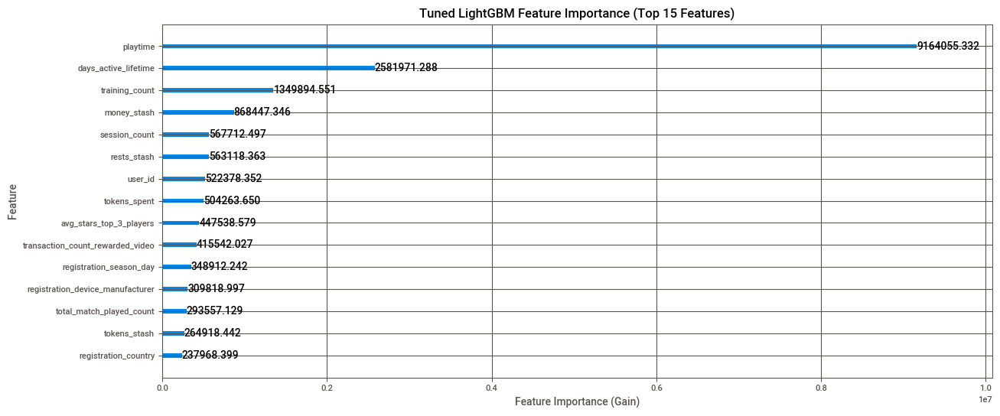

In [131]:
# Plot feature importance using the tuned LightGBM model
lgb.plot_importance(tuned_lgb_model, max_num_features=15, importance_type='gain', ignore_zero=True, figsize=(14, 6))
plt.title("Tuned LightGBM Feature Importance (Top 15 Features)")
plt.xlabel("Feature Importance (Gain)")
plt.ylabel("Feature")
plt.show()

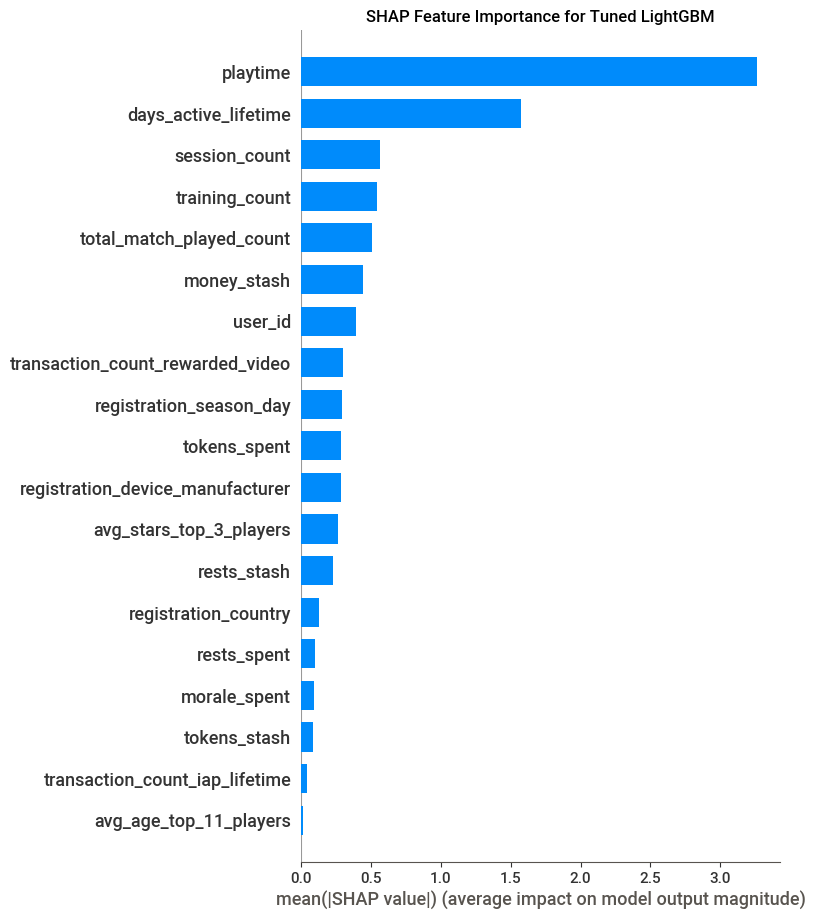

In [132]:
# Convert the scaled validation data back to a DataFrame
X_val_scaled_df = pd.DataFrame(X_val_scaled, columns=X_train.columns)

# Initialize the SHAP explainer with the tuned LightGBM model
explainer = shap.TreeExplainer(tuned_lgb_model)
shap_values = explainer.shap_values(X_val_scaled_df)

# Create a SHAP summary plot (bar plot)
shap.summary_plot(shap_values, X_val_scaled_df, plot_type="bar", show=False)
plt.title("SHAP Feature Importance for Tuned LightGBM")
plt.show()

Feature importance plots logged to MLflow.


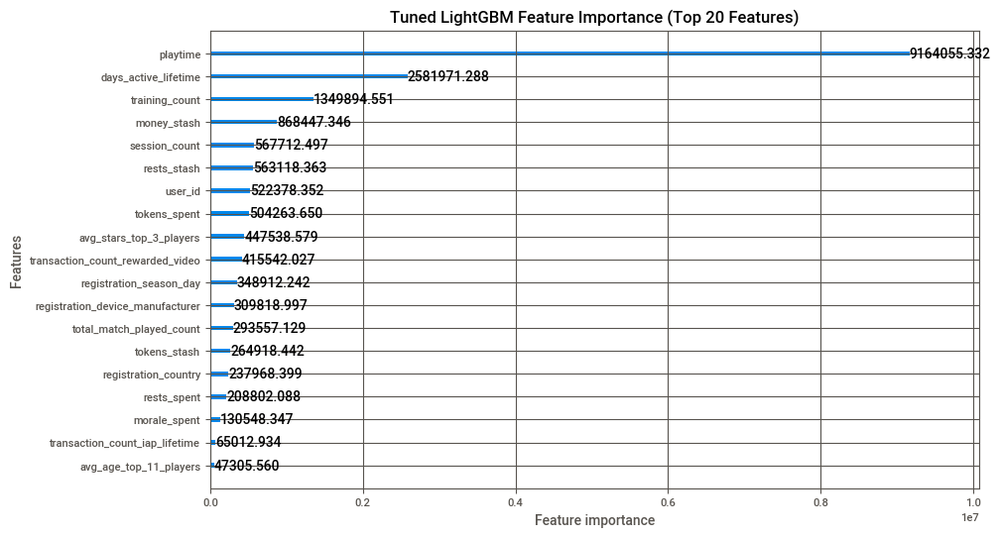

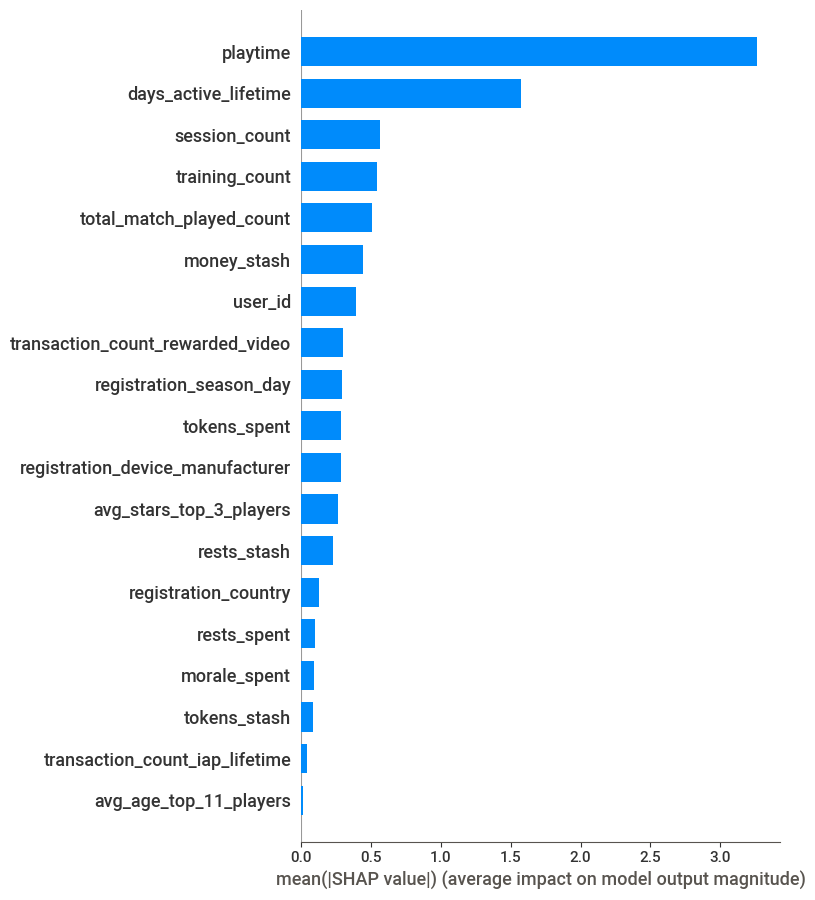

In [ ]:
mlflow.end_run()

with mlflow.start_run(run_name="Tuned_LightGBM_Interpretability"):
    # Log the tuned LightGBM model
    mlflow.log_params(best_lgb_params)
    mlflow.sklearn.log_model(tuned_lgb_model, "Tuned_LightGBM_Model")

    # Log LightGBM Feature Importance Plot
    fig, ax = plt.subplots(figsize=(10, 6))
    lgb.plot_importance(tuned_lgb_model, max_num_features=20, importance_type='gain', ax=ax)
    plt.title("Tuned LightGBM Feature Importance (Top 20 Features)")
    plt.savefig(r"C:\Users\User\Projects_for_Competitions_Companies\Nordeus_Data_Science_Challenge_2024\docs\tuned_lgb_feature_importance.png")
    mlflow.log_artifact("tuned_lgb_feature_importance.png")

    # Log SHAP Summary Plot
    plt.figure()
    shap.summary_plot(shap_values, X_val, plot_type="bar", show=False)
    plt.savefig(r"C:\Users\User\Projects_for_Competitions_Companies\Nordeus_Data_Science_Challenge_2024\docs\tuned_shap_summary_plot.png")
    mlflow.log_artifact("tuned_shap_summary_plot.png")

print("Feature importance plots logged to MLflow.")

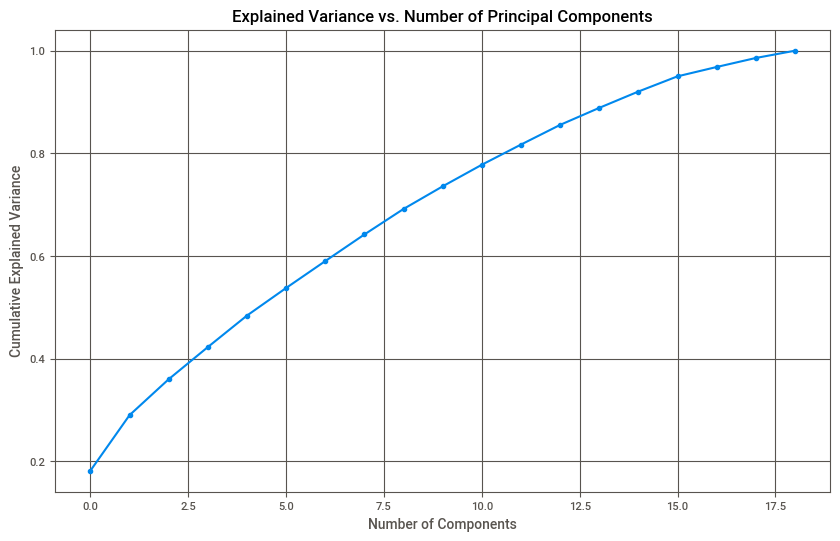

In [134]:
# Initialize PCA
pca = PCA()

# Fit PCA on the scaled training data
pca.fit(X_train_scaled)

# Plot the explained variance ratio to determine the number of components
plt.figure(figsize=(10, 6))
plt.plot(np.cumsum(pca.explained_variance_ratio_), marker='o')
plt.xlabel("Number of Components")
plt.ylabel("Cumulative Explained Variance")
plt.title("Explained Variance vs. Number of Principal Components")
plt.grid()
plt.show()

In [135]:
# Initialize PCA with the selected number of components
pca = PCA(n_components=0.9)

# Fit PCA on the training data and transform both training and validation sets
X_train_pca = pca.fit_transform(X_train_scaled)
X_val_pca = pca.transform(X_val_scaled)

print(f"Reduced dimensions: {X_train_pca.shape[1]}")

Reduced dimensions: 15


In [136]:
# Retrain the LightGBM model using PCA-transformed data
pca_lgb_model = lgb.LGBMRegressor(**best_lgb_params)
pca_lgb_model.fit(
    X_train_pca, y_train,
    eval_set=[(X_val_pca, y_val)],
    callbacks=[lgb.early_stopping(stopping_rounds=100), lgb.log_evaluation(-1)]
)

# Evaluate the model
y_pred_pca = pca_lgb_model.predict(X_val_pca)
mae_pca = mean_absolute_error(y_val, y_pred_pca)

print(f"Tuned LightGBM Model MAE with PCA: {mae_pca:.4f}")

Training until validation scores don't improve for 100 rounds
Early stopping, best iteration is:
[173]	valid_0's l2: 65.7211
Tuned LightGBM Model MAE with PCA: 6.1141


In [137]:
# Print the comparison of MAE
print(f"Original Tuned LightGBM MAE: {mae:.4f}")
print(f"\nTuned LightGBM MAE with PCA: {mae_pca:.4f}")

Original Tuned LightGBM MAE: 5.8117

Tuned LightGBM MAE with PCA: 6.1141


In [139]:
# Save the final model
joblib.dump(tuned_lgb_model, r"C:\Users\User\Projects_for_Competitions_Companies\Nordeus_Data_Science_Challenge_2024\models\tuned_lgb_model.pkl")
print("Tuned LightGBM model saved as 'tuned_lgb_model.pkl'")

Tuned LightGBM model saved as 'tuned_lgb_model.pkl'


In [141]:
# Rebuild the FFNN model using the best parameters from Optuna
def build_best_ffnn(params):
    model = Sequential()
    model.add(Input(shape=(X_train_scaled.shape[1],)))
    model.add(Dense(params['n_neurons'], activation='relu'))
    model.add(Dropout(params['dropout_rate']))
    for _ in range(params['n_layers'] - 1):
        model.add(Dense(params['n_neurons'], activation='relu'))
        model.add(Dropout(params['dropout_rate']))
    model.add(Dense(1))  # Output layer for regression

    # Compile the model
    optimizer = Adam(learning_rate=params['learning_rate'])
    model.compile(optimizer=optimizer, loss='mean_absolute_error')

    return model

# Rebuild the FFNN model using the best parameters
best_ffnn_model = build_best_ffnn(best_ffnn_params)

# Train the model
history = best_ffnn_model.fit(
    X_train_scaled, y_train,
    validation_data=(X_val_scaled, y_val),
    epochs=best_ffnn_params['epochs'],
    batch_size=best_ffnn_params['batch_size'],
    verbose=1
)

# Save the model using the native Keras format
best_ffnn_model.save(r"C:\Users\User\Projects_for_Competitions_Companies\Nordeus_Data_Science_Challenge_2024\models\best_ffnn_model.keras")
print("Best FFNN model saved as 'best_ffnn_model.keras'")

Train on 40000 samples, validate on 10000 samples
Epoch 1/66
40000/40000 [==============================] - 4s 91us/sample - loss: 5.9595 - val_loss: 5.6457
Epoch 2/66
40000/40000 [==============================] - 3s 77us/sample - loss: 5.6280 - val_loss: 5.5231
Epoch 3/66
40000/40000 [==============================] - 3s 73us/sample - loss: 5.5257 - val_loss: 5.4537
Epoch 4/66
40000/40000 [==============================] - 3s 77us/sample - loss: 5.4695 - val_loss: 5.4125
Epoch 5/66
40000/40000 [==============================] - 3s 66us/sample - loss: 5.4419 - val_loss: 5.4154
Epoch 6/66
40000/40000 [==============================] - 3s 63us/sample - loss: 5.4078 - val_loss: 5.4010
Epoch 7/66
40000/40000 [==============================] - 3s 68us/sample - loss: 5.4019 - val_loss: 5.3978
Epoch 8/66
40000/40000 [==============================] - 3s 79us/sample - loss: 5.3624 - val_loss: 5.3916
Epoch 9/66
40000/40000 [==============================] - 2s 59us/sample - loss: 5.3801 - val_